# Sentiment Classification & How To "Frame Problems" for a Neural Network

### Pre-requisites before implementing

- neural networks, forward and back-propagation
- stochastic gradient descent
- mean squared error
- and train/test splits


# Lesson: Curate a Dataset

In [1]:
def pretty_print_review_and_label(i):
    print(labels[i] + "\t:\t" + reviews[i][:80] + "...")

g = open('reviews.txt','r') # What we know!
reviews = list(map(lambda x:x[:-1],g.readlines()))
g.close()

g = open('labels.txt','r') # What we WANT to know!
labels = list(map(lambda x:x[:-1].upper(),g.readlines()))
g.close()

**Note:** The data in `reviews.txt` we're using has already been preprocessed a bit and contains only lower case characters. If we were working from raw data, where we didn't know it was all lower case, we would want to add a step here to convert it. That's so we treat different variations of the same word, like `The`, `the`, and `THE`, all the same way.

In [2]:
len(reviews)

25000

In [3]:
reviews[0]

'bromwell high is a cartoon comedy . it ran at the same time as some other programs about school life  such as  teachers  . my   years in the teaching profession lead me to believe that bromwell high  s satire is much closer to reality than is  teachers  . the scramble to survive financially  the insightful students who can see right through their pathetic teachers  pomp  the pettiness of the whole situation  all remind me of the schools i knew and their students . when i saw the episode in which a student repeatedly tried to burn down the school  i immediately recalled . . . . . . . . . at . . . . . . . . . . high . a classic line inspector i  m here to sack one of your teachers . student welcome to bromwell high . i expect that many adults of my age think that bromwell high is far fetched . what a pity that it isn  t   '

In [4]:
labels[0]

'POSITIVE'

# Lesson: Develop a Predictive Theory<a id='lesson_2'></a>

In [5]:
print("labels.txt \t : \t reviews.txt\n")
pretty_print_review_and_label(2137)
pretty_print_review_and_label(12816)
pretty_print_review_and_label(6267)
pretty_print_review_and_label(21934)
pretty_print_review_and_label(5297)
pretty_print_review_and_label(4998)

labels.txt 	 : 	 reviews.txt

NEGATIVE	:	this movie is terrible but it has some good effects .  ...
POSITIVE	:	adrian pasdar is excellent is this film . he makes a fascinating woman .  ...
NEGATIVE	:	comment this movie is impossible . is terrible  very improbable  bad interpretat...
POSITIVE	:	excellent episode movie ala pulp fiction .  days   suicides . it doesnt get more...
NEGATIVE	:	if you haven  t seen this  it  s terrible . it is pure trash . i saw this about ...
POSITIVE	:	this schiffer guy is a real genius  the movie is of excellent quality and both e...


# Project 1: Quick Theory Validation

In [6]:
from collections import Counter
import numpy as np


We'll create three `Counter` objects, one for words from positive reviews, one for words from negative reviews, and one for all the words.

In [7]:
# Create three Counter objects to store positive, negative and total counts
positive_counts = Counter()
negative_counts = Counter()
total_counts = Counter()

**TODO:** Examine all the reviews. For each word in a positive review, increase the count for that word in both your positive counter and the total words counter; likewise, for each word in a negative review, increase the count for that word in both your negative counter and the total words counter.

**Note:** Throughout these projects, you should use `split(' ')` to divide a piece of text (such as a review) into individual words. If you use `split()` instead, you'll get slightly different results than what the videos and solutions show.

In [8]:
# TODO: Loop over all the words in all the reviews and increment the counts in the appropriate counter objects
for i in range(len(reviews)):
    if (labels[i] == 'POSITIVE'):
        for wrd in reviews[i].split(' '):
            positive_counts[wrd] += 1
            total_counts[wrd] += 1
    else:
        for wrd in reviews[i].split(' '):
            negative_counts[wrd] += 1
            total_counts[wrd] += 1


Run the following two cells to list the words used in positive reviews and negative reviews, respectively, ordered from most to least commonly used. 

In [9]:
# Examine the counts of the most common words in positive reviews
positive_counts.most_common()

[('', 550468),
 ('the', 173324),
 ('.', 159654),
 ('and', 89722),
 ('a', 83688),
 ('of', 76855),
 ('to', 66746),
 ('is', 57245),
 ('in', 50215),
 ('br', 49235),
 ('it', 48025),
 ('i', 40743),
 ('that', 35630),
 ('this', 35080),
 ('s', 33815),
 ('as', 26308),
 ('with', 23247),
 ('for', 22416),
 ('was', 21917),
 ('film', 20937),
 ('but', 20822),
 ('movie', 19074),
 ('his', 17227),
 ('on', 17008),
 ('you', 16681),
 ('he', 16282),
 ('are', 14807),
 ('not', 14272),
 ('t', 13720),
 ('one', 13655),
 ('have', 12587),
 ('be', 12416),
 ('by', 11997),
 ('all', 11942),
 ('who', 11464),
 ('an', 11294),
 ('at', 11234),
 ('from', 10767),
 ('her', 10474),
 ('they', 9895),
 ('has', 9186),
 ('so', 9154),
 ('like', 9038),
 ('about', 8313),
 ('very', 8305),
 ('out', 8134),
 ('there', 8057),
 ('she', 7779),
 ('what', 7737),
 ('or', 7732),
 ('good', 7720),
 ('more', 7521),
 ('when', 7456),
 ('some', 7441),
 ('if', 7285),
 ('just', 7152),
 ('can', 7001),
 ('story', 6780),
 ('time', 6515),
 ('my', 6488),
 ('g

In [10]:
# Examine the counts of the most common words in negative reviews
negative_counts.most_common()

[('', 561462),
 ('.', 167538),
 ('the', 163389),
 ('a', 79321),
 ('and', 74385),
 ('of', 69009),
 ('to', 68974),
 ('br', 52637),
 ('is', 50083),
 ('it', 48327),
 ('i', 46880),
 ('in', 43753),
 ('this', 40920),
 ('that', 37615),
 ('s', 31546),
 ('was', 26291),
 ('movie', 24965),
 ('for', 21927),
 ('but', 21781),
 ('with', 20878),
 ('as', 20625),
 ('t', 20361),
 ('film', 19218),
 ('you', 17549),
 ('on', 17192),
 ('not', 16354),
 ('have', 15144),
 ('are', 14623),
 ('be', 14541),
 ('he', 13856),
 ('one', 13134),
 ('they', 13011),
 ('at', 12279),
 ('his', 12147),
 ('all', 12036),
 ('so', 11463),
 ('like', 11238),
 ('there', 10775),
 ('just', 10619),
 ('by', 10549),
 ('or', 10272),
 ('an', 10266),
 ('who', 9969),
 ('from', 9731),
 ('if', 9518),
 ('about', 9061),
 ('out', 8979),
 ('what', 8422),
 ('some', 8306),
 ('no', 8143),
 ('her', 7947),
 ('even', 7687),
 ('can', 7653),
 ('has', 7604),
 ('good', 7423),
 ('bad', 7401),
 ('would', 7036),
 ('up', 6970),
 ('only', 6781),
 ('more', 6730),
 ('

As you can see, common words like "the" appear very often in both positive and negative reviews. Instead of finding the most common words in positive or negative reviews, what you really want are the words found in positive reviews more often than in negative reviews, and vice versa. To accomplish this, you'll need to calculate the **ratios** of word usage between positive and negative reviews.

**TODO:** Check all the words you've seen and calculate the ratio of positive to negative uses and store that ratio in `pos_neg_ratios`. 
>Hint: the positive-to-negative ratio for a given word can be calculated with `positive_counts[word] / float(negative_counts[word]+1)`. Notice the `+1` in the denominator – that ensures we don't divide by zero for words that are only seen in positive reviews.

In [11]:
# Create Counter object to store positive/negative ratios
pos_neg_ratios = Counter()

# TODO: Calculate the ratios of positive and negative uses of the most common words
#       Consider words to be "common" if they've been used at least 100 times
for term,cnt in list(total_counts.most_common()):
    if cnt > 100:
        pos_neg_ratio = positive_counts[term] / float(negative_counts[term]+1)
        pos_neg_ratios[term] = pos_neg_ratio




In [12]:
list(reversed(pos_neg_ratios.most_common()))

[('boll', 0.006944444444444444),
 ('uwe', 0.00980392156862745),
 ('seagal', 0.026143790849673203),
 ('unwatchable', 0.038461538461538464),
 ('stinker', 0.04040404040404041),
 ('mst', 0.05232558139534884),
 ('incoherent', 0.05303030303030303),
 ('unfunny', 0.06772908366533864),
 ('waste', 0.0728476821192053),
 ('blah', 0.07650273224043716),
 ('horrid', 0.08333333333333333),
 ('pointless', 0.08583690987124463),
 ('atrocious', 0.08839779005524862),
 ('redeeming', 0.09364548494983277),
 ('prom', 0.09433962264150944),
 ('drivel', 0.09565217391304348),
 ('lousy', 0.09950248756218906),
 ('worst', 0.10157194679564692),
 ('laughable', 0.1038961038961039),
 ('awful', 0.10783055198973042),
 ('poorly', 0.10852713178294573),
 ('wasting', 0.11029411764705882),
 ('remotely', 0.1111111111111111),
 ('existent', 0.125),
 ('boredom', 0.136),
 ('miserably', 0.13636363636363635),
 ('sucks', 0.13709677419354838),
 ('uninspired', 0.13761467889908258),
 ('lame', 0.13782542113323124),
 ('insult', 0.13829787234

Examine the ratios you've calculated for a few words:

In [13]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 1.0607993145235326
Pos-to-neg ratio for 'amazing' = 4.022813688212928
Pos-to-neg ratio for 'terrible' = 0.17744252873563218


Looking closely at the values you just calculated, we see the following:

* Words that you would expect to see more often in positive reviews – like "amazing" – have a ratio greater than 1. The more skewed a word is toward postive, the farther from 1 its positive-to-negative ratio  will be.
* Words that you would expect to see more often in negative reviews – like "terrible" – have positive values that are less than 1. The more skewed a word is toward negative, the closer to zero its positive-to-negative ratio will be.
* Neutral words, which don't really convey any sentiment because you would expect to see them in all sorts of reviews – like "the" – have values very close to 1. A perfectly neutral word – one that was used in exactly the same number of positive reviews as negative reviews – would be almost exactly 1. The `+1` we suggested you add to the denominator slightly biases words toward negative, but it won't matter because it will be a tiny bias and later we'll be ignoring words that are too close to neutral anyway.

Ok, the ratios tell us which words are used more often in positive or negative reviews, but the specific values we've calculated are a bit difficult to work with. A very positive word like "amazing" has a value above 4, whereas a very negative word like "terrible" has a value around 0.18. Those values aren't easy to compare for a couple of reasons:

* Right now, 1 is considered neutral, but the absolute value of the postive-to-negative rations of very positive words is larger than the absolute value of the ratios for the very negative words. So there is no way to directly compare two numbers and see if one word conveys the same magnitude of positive sentiment as another word conveys negative sentiment. So we should center all the values around netural so the absolute value fro neutral of the postive-to-negative ratio for a word would indicate how much sentiment (positive or negative) that word conveys.
* When comparing absolute values it's easier to do that around zero than one. 

To fix these issues, we'll convert all of our ratios to new values using logarithms.

**TODO:** Go through all the ratios you calculated and convert them to logarithms. (i.e. use `np.log(ratio)`)

In the end, extremely positive and extremely negative words will have positive-to-negative ratios with similar magnitudes but opposite signs.

In [14]:
# TODO: Convert ratios to logs
for word, ratio in pos_neg_ratios.most_common():
    if ratio > 1:
        pos_neg_ratios[word] = np.log(ratio)
    else:
        pos_neg_ratios[word] = -np.log(1 / (ratio+0.01))

Examine the new ratios you've calculated for the same words from before:

In [15]:
print("Pos-to-neg ratio for 'the' = {}".format(pos_neg_ratios["the"]))
print("Pos-to-neg ratio for 'amazing' = {}".format(pos_neg_ratios["amazing"]))
print("Pos-to-neg ratio for 'terrible' = {}".format(pos_neg_ratios["terrible"]))

Pos-to-neg ratio for 'the' = 0.05902269426102881
Pos-to-neg ratio for 'amazing' = 1.3919815802404802
Pos-to-neg ratio for 'terrible' = -1.6742829939664696


If everything worked, now you should see neutral words with values close to zero. In this case, "the" is near zero but slightly positive, so it was probably used in more positive reviews than negative reviews. But look at "amazing"'s ratio - it's above `1`, showing it is clearly a word with positive sentiment. And "terrible" has a similar score, but in the opposite direction, so it's below `-1`. It's now clear that both of these words are associated with specific, opposing sentiments.

Now run the following cells to see more ratios. 

The first cell displays all the words, ordered by how associated they are with positive reviews. (Your notebook will most likely truncate the output so you won't actually see *all* the words in the list.)

The second cell displays the 30 words most associated with negative reviews by reversing the order of the first list and then looking at the first 30 words. (If you want the second cell to display all the words, ordered by how associated they are with negative reviews, you could just write `reversed(pos_neg_ratios.most_common())`.)

You should continue to see values similar to the earlier ones we checked – neutral words will be close to `0`, words will get more positive as their ratios approach and go above `1`, and words will get more negative as their ratios approach and go below `-1`. That's why we decided to use the logs instead of the raw ratios.

In [16]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('paulie', 4.07753744390572),
 ('felix', 3.152736022363656),
 ('polanski', 2.8233610476132043),
 ('matthau', 2.80672172860924),
 ('victoria', 2.681021528714291),
 ('mildred', 2.6026896854443837),
 ('gandhi', 2.538973871058276),
 ('flawless', 2.451005098112319),
 ('superbly', 2.26002547857525),
 ('perfection', 2.159484249353372),
 ('astaire', 2.1400661634962708),
 ('captures', 2.038619547159581),
 ('voight', 2.030170492673053),
 ('wonderfully', 2.0218960560332353),
 ('powell', 1.978345424808467),
 ('brosnan', 1.9547990964725592),
 ('lily', 1.9203768470501485),
 ('bakshi', 1.9029851043382795),
 ('lincoln', 1.9014583864844796),
 ('refreshing', 1.8551812956655511),
 ('breathtaking', 1.8481124057791867),
 ('bourne', 1.8478489358790986),
 ('lemmon', 1.8458266904983307),
 ('delightful', 1.8002701588959635),
 ('flynn', 1.7996646487351682),
 ('andrews', 1.7764919970972666),
 ('homer', 1.7692866133759964),
 ('beautifully', 1.7626953362841438),
 ('soccer', 1.757857

In [17]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]


[('boll', -4.07781526027089),
 ('uwe', -3.921875301871158),
 ('seagal', -3.320250105858192),
 ('unwatchable', -3.0269848170580955),
 ('stinker', -2.9876839403711624),
 ('mst', -2.775383321170797),
 ('incoherent', -2.7641396677532537),
 ('unfunny', -2.5545257844967644),
 ('waste', -2.4907515123361046),
 ('blah', -2.4475792789485005),
 ('horrid', -2.371577964480997),
 ('pointless', -2.345107387713634),
 ('atrocious', -2.3187369339642556),
 ('redeeming', -2.2667790015910296),
 ('prom', -2.2601040980178784),
 ('drivel', -2.247602958576693),
 ('lousy', -2.2118080125207054),
 ('worst', -2.1930856334332267),
 ('laughable', -2.172468615469592),
 ('awful', -2.1385076866397488),
 ('poorly', -2.132613384420701),
 ('wasting', -2.117815554561451),
 ('remotely', -2.111046881095167),
 ('existent', -2.0024805005437076),
 ('boredom', -1.9241486572738005),
 ('miserably', -1.921661093801999),
 ('sucks', -1.9166645809588516),
 ('uninspired', -1.9131499212248517),
 ('lame', -1.9117232884159072),
 ('insult'

# End of Project 1. 

# Transforming Text into Numbers

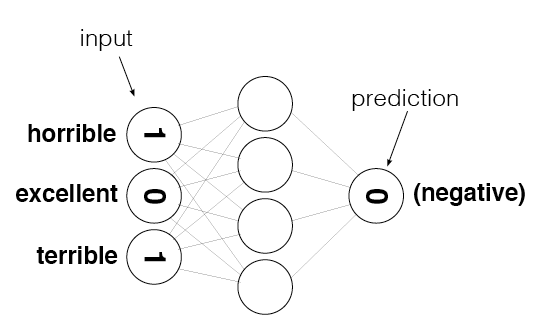

In [18]:
from IPython.display import Image

review = "This was a horrible, terrible movie."

Image(filename='sentiment_network.png')

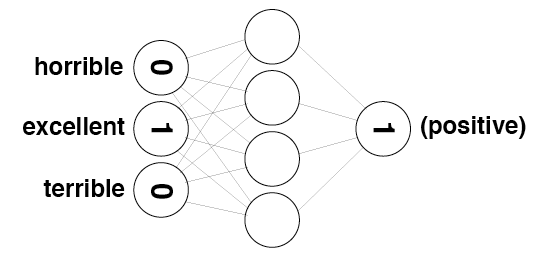

In [19]:
review = "The movie was excellent"

Image(filename='sentiment_network_pos.png')

# Project 2: Creating the Input/Output Data<a id='project_2'></a>

**TODO:** Create a [set](https://docs.python.org/3/tutorial/datastructures.html#sets) named `vocab` that contains every word in the vocabulary.

In [20]:
# TODO: Create set named "vocab" containing all of the words from all of the reviews
vocab = set(total_counts.keys())

Run the following cell to check your vocabulary size. If everything worked correctly, it should print **74074**

In [21]:
vocab_size = len(vocab)
print(vocab_size)

74074


Take a look at the following image. It represents the layers of the neural network you'll be building throughout this notebook. `layer_0` is the input layer, `layer_1` is a hidden layer, and `layer_2` is the output layer.

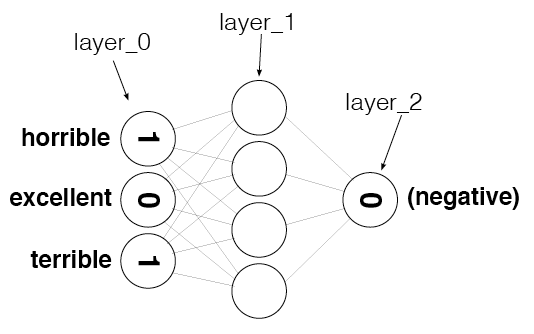

In [22]:
from IPython.display import Image
Image(filename='sentiment_network_2.png')

**TODO:** Create a numpy array called `layer_0` and initialize it to all zeros. You will find the [zeros](https://docs.scipy.org/doc/numpy/reference/generated/numpy.zeros.html) function particularly helpful here. Be sure you create `layer_0` as a 2-dimensional matrix with 1 row and `vocab_size` columns. 

In [23]:
# TODO: Create layer_0 matrix with dimensions 1 by vocab_size, initially filled with zeros
layer_0 = np.zeros((1,vocab_size))
layer_0

array([[0., 0., 0., ..., 0., 0., 0.]])

Run the following cell. It should display `(1, 74074)`

In [24]:
layer_0.shape

(1, 74074)

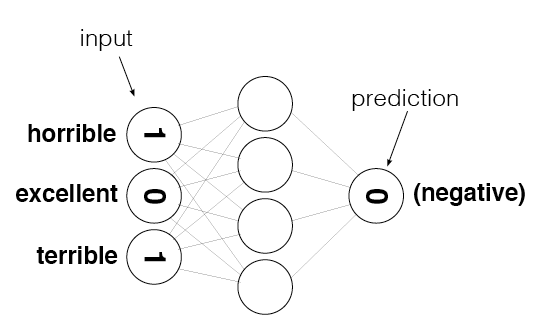

In [25]:
from IPython.display import Image
Image(filename='sentiment_network.png')

`layer_0` contains one entry for every word in the vocabulary, as shown in the above image. We need to make sure we know the index of each word, so run the following cell to create a lookup table that stores the index of every word.

In [26]:
# Create a dictionary of words in the vocabulary mapped to index positions
# (to be used in layer_0)
word2index = {}
for i,word in enumerate(vocab):
    word2index[word] = i
    
# display the map of words to indices
word2index

{'': 0,
 'ranchhouse': 1,
 'paramilitary': 2,
 'geologists': 3,
 'combats': 4,
 'fascinates': 5,
 'fmvs': 6,
 'flipper': 7,
 'teleport': 8,
 'joachim': 9,
 'boxlietner': 10,
 'transparencies': 11,
 'catcalls': 12,
 'coalville': 13,
 'princely': 14,
 'bowden': 15,
 'communions': 16,
 'intertwine': 17,
 'yearned': 18,
 'americanizing': 19,
 'disorienting': 20,
 'pacify': 21,
 'simplistic': 22,
 'apology': 23,
 'scouser': 24,
 'section': 25,
 'cohort': 26,
 'chacotero': 27,
 'elaborate': 28,
 'minging': 29,
 'coooofffffffiiiiinnnnn': 30,
 'intimated': 31,
 'waacky': 32,
 'panavision': 33,
 'discard': 34,
 'roslin': 35,
 'servers': 36,
 'ferb': 37,
 'understated': 38,
 'pies': 39,
 'tearoom': 40,
 'traumas': 41,
 'generalities': 42,
 'holbrook': 43,
 'pitzalis': 44,
 'peasantry': 45,
 'fads': 46,
 'fornicating': 47,
 'nastassja': 48,
 'obtrusive': 49,
 'transexual': 50,
 'sebastiaans': 51,
 'subverts': 52,
 'iben': 53,
 'decor': 54,
 'telekenisis': 55,
 'supurb': 56,
 'perry': 57,
 'pittma

**TODO:**  Complete the implementation of `update_input_layer`. It should count 
          how many times each word is used in the given review, and then store
          those counts at the appropriate indices inside `layer_0`.

In [27]:
def update_input_layer(review):
    """ Modify the global layer_0 to represent the vector form of review.
    The element at a given index of layer_0 should represent
    how many times the given word occurs in the review.
    Args:
        review(string) - the string of the review
    Returns:
        None
    """
    global layer_0
    # clear out previous state by resetting the layer to be all 0s
    layer_0 *= 0
           
    
    # TODO: count how many times each word is used in the given review and store the results in layer_0 
    for word in review.split(" "):
        layer_0[0][word2index[word]] += 1
update_input_layer(reviews[0])

Run the following cell to test updating the input layer with the first review. The indices assigned may not be the same as in the solution, but hopefully you'll see some non-zero values in `layer_0`.  

In [28]:
update_input_layer(reviews[0])
layer_0

array([[18.,  0.,  0., ...,  0.,  0.,  0.]])

**TODO:** Complete the implementation of `get_target_for_labels`. It should return `0` or `1`, 
          depending on whether the given label is `NEGATIVE` or `POSITIVE`, respectively.

In [29]:
def get_target_for_label(label):
    """Convert a label to `0` or `1`.
    Args:
        label(string) - Either "POSITIVE" or "NEGATIVE".
    Returns:
        `0` or `1`.
    """
    # TODO: Your code here
    if label == 'POSITIVE':
        return 1
    else:
        return 0

Run the following two cells. They should print out`'POSITIVE'` and `1`, respectively.

In [30]:
labels[0]

'POSITIVE'

In [31]:
get_target_for_label(labels[0])

1

Run the following two cells. They should print out `'NEGATIVE'` and `0`, respectively.

In [32]:
labels[1]

'NEGATIVE'

In [33]:
get_target_for_label(labels[1])

0

# End of Project 2. 

# Project 3: Building a Neural Network<a id='project_3'></a>

**TODO:** We've included the framework of a class called `SentimentNetork`. Implement all of the items marked `TODO` in the code. These include doing the following:
- Create a basic neural network much like the networks you've seen in earlier lessons and in Project 1, with an input layer, a hidden layer, and an output layer. 
- Do **not** add a non-linearity in the hidden layer. That is, do not use an activation function when calculating the hidden layer outputs.
- Re-use the code from earlier in this notebook to create the training data (see `TODO`s in the code)
- Implement the `pre_process_data` function to create the vocabulary for our training data generating functions
- Ensure `train` trains over the entire corpus

In [34]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducible results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            for word in review.split(" "):
                review_vocab.add(word)
                
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        for label in labels:
            label_vocab.add(label)
            
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for i,word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for i,label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5,(self.hidden_nodes,self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1,input_nodes))
    
        
    def update_input_layer(self, review):
        # TODO: You can copy most of the code you wrote for update_input_layer 
        #       earlier in this notebook. 
        #
        #       However, MAKE SURE YOU CHANGE ALL VARIABLES TO REFERENCE
        #       THE VERSIONS STORED IN THIS OBJECT, NOT THE GLOBAL OBJECTS.
        #       For example, replace "layer_0 *= 0" with "self.layer_0 *= 0"
        # clear out previous state by resetting the layer to be all 0s
        self.layer_0 *= 0


        # TODO: count how many times each word is used in the given review and store the results in layer_0 
        for word in review.split(" "):
            if word in self.word2index.keys():
                self.layer_0[0][self.word2index[word]] += 1
                
    def get_target_for_label(self,label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        # TODO: Your code here
        if label == 'POSITIVE':
            return 1
        else:
            return 0
        
    def sigmoid(self,x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return (1 / (1 + np.exp(-x)))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            # Input layer
            self.update_input_layer(review)
            
            # Hidden layer
            layer_1 = self.layer_0.dot(self.weights_0_1)
            
            # Output layer
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            
            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label)
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)
            
            # Backporpagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T)
            layer_1_delta = layer_1_error
            
            # Update weights
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta) * self.learning_rate
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta) * self.learning_rate
            
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            
            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
                
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # Input layer
        self.update_input_layer(review.lower())

        # Hidden layer
        layer_1 = self.layer_0.dot(self.weights_0_1)

        # Output layer
        layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        
        if (layer_2[0] > 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to create a `SentimentNetwork` that will train on all but the last 1000 reviews (we're saving those for testing). Here we use a learning rate of `0.1`.

In [35]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)

Run the following cell to test the network's performance against the last 1000 reviews (the ones we held out from our training set). 

**We have not trained the model yet, so the results should be about 50% as it will just be guessing and there are only two possible values to choose from.**

In [36]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:23.6% Speed(reviews/sec):1272. #Correct:118 #Tested:237 Testing Accuracy:49.7%

Progress:48.4% Speed(reviews/sec):1297. #Correct:242 #Tested:485 Testing Accuracy:49.8%

Progress:65.5% Speed(reviews/sec):1170. #Correct:328 #Tested:656 Testing Accuracy:50.0%

Progress:82.6% Speed(reviews/sec):1104. #Correct:413 #Tested:827 Testing Accuracy:49.9%

Progress:99.9% Speed(reviews/sec):1124. #Correct:500 #Tested:1000 Testing Accuracy:50.0%

Run the following cell to actually train the network. During training, it will display the model's accuracy repeatedly as it trains so you can see how well it's doing.

In [37]:
mlp.train(reviews[:-1000], labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):140.9 #Correct:1251 #Trained:2501 Training Accuracy:50.0%
Progress:20.8% Speed(reviews/sec):148.0 #Correct:2501 #Trained:5001 Training Accuracy:50.0%
Progress:31.2% Speed(reviews/sec):149.3 #Correct:3751 #Trained:7501 Training Accuracy:50.0%
Progress:41.6% Speed(reviews/sec):152.7 #Correct:5001 #Trained:10001 Training Accuracy:50.0%
Progress:52.0% Speed(reviews/sec):151.6 #Correct:6251 #Trained:12501 Training Accuracy:50.0%
Progress:62.5% Speed(reviews/sec):153.8 #Correct:7501 #Trained:15001 Training Accuracy:50.0%
Progress:72.9% Speed(reviews/sec):154.3 #Correct:8751 #Trained:17501 Training Accuracy:50.0%
Progress:83.3% Speed(reviews/sec):155.3 #Correct:10001 #Trained:20001 Training Accuracy:50.0%
Progress:93.7% Speed(reviews/sec):156.2 #Correct:11251 #Trained:22501 Training Accuracy:50.0%
Progress:99.9% Speed(reviews/sec):156.8 #Correct:12000 #Trained:24000 Training Ac

That most likely didn't train very well. Part of the reason may be because the learning rate is too high. Run the following cell to recreate the network with a smaller learning rate, `0.01`, and then train the new network.

In [38]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.01)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):160.6 #Correct:1248 #Trained:2501 Training Accuracy:49.9%
Progress:20.8% Speed(reviews/sec):161.6 #Correct:2498 #Trained:5001 Training Accuracy:49.9%
Progress:31.2% Speed(reviews/sec):161.5 #Correct:3748 #Trained:7501 Training Accuracy:49.9%
Progress:41.6% Speed(reviews/sec):161.0 #Correct:4998 #Trained:10001 Training Accuracy:49.9%
Progress:52.0% Speed(reviews/sec):161.1 #Correct:6248 #Trained:12501 Training Accuracy:49.9%
Progress:62.5% Speed(reviews/sec):161.2 #Correct:7490 #Trained:15001 Training Accuracy:49.9%
Progress:72.9% Speed(reviews/sec):160.5 #Correct:8742 #Trained:17501 Training Accuracy:49.9%
Progress:83.3% Speed(reviews/sec):161.0 #Correct:9992 #Trained:20001 Training Accuracy:49.9%
Progress:93.7% Speed(reviews/sec):160.7 #Correct:11242 #Trained:22501 Training Accuracy:49.9%
Progress:99.9% Speed(reviews/sec):159.7 #Correct:11991 #Trained:24000 Training Acc

That probably wasn't much different. Run the following cell to recreate the network one more time with an even smaller learning rate, `0.001`, and then train the new network.

In [39]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.001)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):167.9 #Correct:1264 #Trained:2501 Training Accuracy:50.5%
Progress:20.8% Speed(reviews/sec):165.4 #Correct:2514 #Trained:5001 Training Accuracy:50.2%
Progress:31.2% Speed(reviews/sec):152.7 #Correct:3850 #Trained:7501 Training Accuracy:51.3%
Progress:41.6% Speed(reviews/sec):150.4 #Correct:5340 #Trained:10001 Training Accuracy:53.3%
Progress:52.0% Speed(reviews/sec):152.0 #Correct:6851 #Trained:12501 Training Accuracy:54.8%
Progress:62.5% Speed(reviews/sec):153.9 #Correct:8418 #Trained:15001 Training Accuracy:56.1%
Progress:72.9% Speed(reviews/sec):154.7 #Correct:9995 #Trained:17501 Training Accuracy:57.1%
Progress:83.3% Speed(reviews/sec):155.8 #Correct:11653 #Trained:20001 Training Accuracy:58.2%
Progress:93.7% Speed(reviews/sec):156.4 #Correct:13329 #Trained:22501 Training Accuracy:59.2%
Progress:99.9% Speed(reviews/sec):156.9 #Correct:14381 #Trained:24000 Training Ac

With a learning rate of `0.001`, the network should finall have started to improve during training. It's still not very good, but it shows that this solution has potential. We will improve it in the next lesson.

# End of Project 3. 

# Understanding Neural Noise

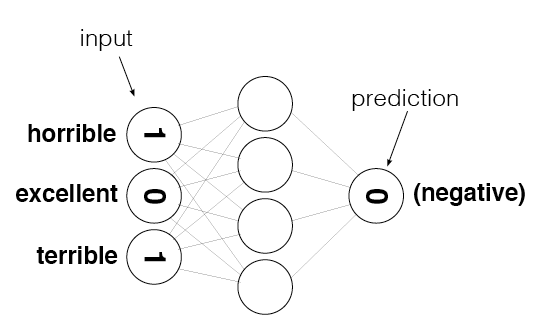

In [40]:
from IPython.display import Image
Image(filename='sentiment_network.png')

In [41]:
def update_input_layer(review):
    
    global layer_0
    
    # clear out previous state, reset the layer to be all 0s
    layer_0 *= 0
    for word in review.split(" "):
        layer_0[0][word2index[word]] += 1

update_input_layer(reviews[0])

In [42]:
layer_0

array([[18.,  0.,  0., ...,  0.,  0.,  0.]])

In [43]:
review_counter = Counter()

In [44]:
for word in reviews[0].split(" "):
    review_counter[word] += 1

In [45]:
review_counter.most_common()

[('.', 27),
 ('', 18),
 ('the', 9),
 ('to', 6),
 ('high', 5),
 ('i', 5),
 ('bromwell', 4),
 ('is', 4),
 ('a', 4),
 ('teachers', 4),
 ('that', 4),
 ('of', 4),
 ('it', 2),
 ('at', 2),
 ('as', 2),
 ('school', 2),
 ('my', 2),
 ('in', 2),
 ('me', 2),
 ('students', 2),
 ('their', 2),
 ('student', 2),
 ('cartoon', 1),
 ('comedy', 1),
 ('ran', 1),
 ('same', 1),
 ('time', 1),
 ('some', 1),
 ('other', 1),
 ('programs', 1),
 ('about', 1),
 ('life', 1),
 ('such', 1),
 ('years', 1),
 ('teaching', 1),
 ('profession', 1),
 ('lead', 1),
 ('believe', 1),
 ('s', 1),
 ('satire', 1),
 ('much', 1),
 ('closer', 1),
 ('reality', 1),
 ('than', 1),
 ('scramble', 1),
 ('survive', 1),
 ('financially', 1),
 ('insightful', 1),
 ('who', 1),
 ('can', 1),
 ('see', 1),
 ('right', 1),
 ('through', 1),
 ('pathetic', 1),
 ('pomp', 1),
 ('pettiness', 1),
 ('whole', 1),
 ('situation', 1),
 ('all', 1),
 ('remind', 1),
 ('schools', 1),
 ('knew', 1),
 ('and', 1),
 ('when', 1),
 ('saw', 1),
 ('episode', 1),
 ('which', 1),
 ('r

Most of the reviews are the filler words!! That does not help the NN to perform better. 

# Project 4: Reducing Noise in Our Input Data<a id='project_4'></a>

**TODO:** Attempt to reduce the noise in the input data. Specifically, do the following:
* Copy the `SentimentNetwork` class you created earlier into the following cell.
* Modify `update_input_layer` so it does not count how many times each word is used, but rather just stores whether or not a word was used. 

In [46]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducible results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            for word in review.split(" "):
                review_vocab.add(word)
                
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        for label in labels:
            label_vocab.add(label)
            
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for i,word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for i,label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5,
                                            (self.hidden_nodes, self.output_nodes))
        
        # TODO: Create the input layer, a two-dimensional matrix with shape 
        #       1 x input_nodes, with all values initialized to zero
        self.layer_0 = np.zeros((1, input_nodes))
    
        
    def update_input_layer(self, review):
        # TODO: You can copy most of the code you wrote for update_input_layer 
        #       earlier in this notebook. 
        #
        #       However, MAKE SURE YOU CHANGE ALL VARIABLES TO REFERENCE
        #       THE VERSIONS STORED IN THIS OBJECT, NOT THE GLOBAL OBJECTS.
        #       For example, replace "layer_0 *= 0" with "self.layer_0 *= 0"
        # clear out previous state by resetting the layer to be all 0s
        self.layer_0 *= 0


        # TODO: count how many times each word is used in the given review and store the results in layer_0 
        for word in review.split(" "):
            if( word in self.word2index.keys()):
                self.layer_0[0][self.word2index[word]] = 1
                
    def get_target_for_label(self, label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        # TODO: Your code here
        if (label == 'POSITIVE'):
            return 1
        else:
            return 0
        
    def sigmoid(self, x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews, training_labels):
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
            # Input layer
            self.update_input_layer(review)
            
            # Hidden layer
            layer_1 = self.layer_0.dot(self.weights_0_1)
            
            # Output layer
            layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            
            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label)
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)
            
            # Backporpagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T)
            layer_1_delta = layer_1_error
            
            # Update weights
            self.weights_1_2 -= layer_1.T.dot(layer_2_delta) * self.learning_rate
            self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta) * self.learning_rate
            
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            
            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
                
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
        # Input layer
        self.update_input_layer(review.lower())

        # Hidden layer
        layer_1 = self.layer_0.dot(self.weights_0_1)

        # Output layer
        layer_2 = self.sigmoid(layer_1.dot(self.weights_1_2))
            
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        
        if (layer_2[0] > 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to recreate the network and train it. Notice we've gone back to the higher learning rate of `0.1`.

In [47]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000], learning_rate=0.1)
mlp.train(reviews[:-1000],labels[:-1000])

Progress:0.0% Speed(reviews/sec):0.0 #Correct:1 #Trained:1 Training Accuracy:100.%
Progress:10.4% Speed(reviews/sec):169.0 #Correct:1800 #Trained:2501 Training Accuracy:71.9%
Progress:20.8% Speed(reviews/sec):156.1 #Correct:3793 #Trained:5001 Training Accuracy:75.8%
Progress:31.2% Speed(reviews/sec):160.1 #Correct:5902 #Trained:7501 Training Accuracy:78.6%
Progress:41.6% Speed(reviews/sec):162.3 #Correct:8035 #Trained:10001 Training Accuracy:80.3%
Progress:52.0% Speed(reviews/sec):161.4 #Correct:10163 #Trained:12501 Training Accuracy:81.2%
Progress:62.5% Speed(reviews/sec):162.6 #Correct:12292 #Trained:15001 Training Accuracy:81.9%
Progress:72.9% Speed(reviews/sec):163.6 #Correct:14413 #Trained:17501 Training Accuracy:82.3%
Progress:83.3% Speed(reviews/sec):163.7 #Correct:16589 #Trained:20001 Training Accuracy:82.9%
Progress:93.7% Speed(reviews/sec):164.2 #Correct:18773 #Trained:22501 Training Accuracy:83.4%
Progress:99.9% Speed(reviews/sec):163.2 #Correct:20094 #Trained:24000 Training

That should have trained much better than the earlier attempts. It's still not wonderful, but it should have improved dramatically. Run the following cell to test your model with 1000 predictions.

In [48]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):1368. #Correct:852 #Tested:1000 Testing Accuracy:85.2%

# End of Project 4. 

# Project 5: Making our Network More Efficient<a id='project_5'></a>
**TODO:** Make the `SentimentNetwork` class more efficient by eliminating unnecessary multiplications and additions that occur during forward and backward propagation. To do that, you can do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Remove the `update_input_layer` function - you will not need it in this version.
* Modify `init_network`:
>* You no longer need a separate input layer, so remove any mention of `self.layer_0`
>* You will be dealing with the old hidden layer more directly, so create `self.layer_1`, a two-dimensional matrix with shape 1 x hidden_nodes, with all values initialized to zero
* Modify `train`:
>* Change the name of the input parameter `training_reviews` to `training_reviews_raw`. This will help with the next step.
>* At the beginning of the function, you'll want to preprocess your reviews to convert them to a list of indices (from `word2index`) that are actually used in the review. Your code should create a local `list` variable named `training_reviews` that should contain a `list` for each review in `training_reviews_raw`. Those lists should contain the indices for words found in the review.
>* Remove call to `update_input_layer`
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* In the forward pass, replace the code that updates `layer_1` with new logic that only adds the weights for the indices used in the review.
>* When updating `weights_0_1`, only update the individual weights that were used in the forward pass.
* Modify `run`:
>* Remove call to `update_input_layer` 
>* Use `self`'s  `layer_1` instead of a local `layer_1` object.
>* Much like you did in `train`, you will need to pre-process the `review` so you can work with word indices, then update `layer_1` by adding weights for the indices used in the review.

In [49]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetworkEff:
    def __init__(self, reviews, labels, hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducible results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        self.pre_process_data(reviews, labels)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    def pre_process_data(self, reviews, labels):
        
        review_vocab = set()
        # TODO: populate review_vocab with all of the words in the given reviews
        #       Remember to split reviews into individual words 
        #       using "split(' ')" instead of "split()".
        
        for review in reviews:
            for word in review.split(" "):
                review_vocab.add(word)
                
        
        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        label_vocab = set()
        # TODO: populate label_vocab with all of the words in the given labels.
        #       There is no need to split the labels because each one is a single word.
        for label in labels:
            label_vocab.add(label)
            
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        # TODO: populate self.word2index with indices for all the words in self.review_vocab
        #       like you saw earlier in the notebook
        for i,word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        # TODO: do the same thing you did for self.word2index and self.review_vocab, 
        #       but for self.label2index and self.label_vocab instead
        for i,label in enumerate(self.label_vocab):
            self.label2index[label] = i
         
        
    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Store the number of nodes in input, hidden, and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights
        
        # TODO: initialize self.weights_0_1 as a matrix of zeros. These are the weights between
        #       the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes, self.hidden_nodes))
        
        # TODO: initialize self.weights_1_2 as a matrix of random values. 
        #       These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5,
                                            (self.hidden_nodes, self.output_nodes))
        
        # The input layer, a two-dimensional matrix with shape 1 x hidden_nodes
        self.layer_1 = np.zeros((1,hidden_nodes))
                       
    def get_target_for_label(self, label):
        # TODO: Copy the code you wrote for get_target_for_label 
        #       earlier in this notebook. 
        # TODO: Your code here
        if (label == 'POSITIVE'):
            return 1
        else:
            return 0
        
    def sigmoid(self, x):
        # TODO: Return the result of calculating the sigmoid activation function
        #       shown in the lectures
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        # TODO: Return the derivative of the sigmoid activation function, 
        #       where "output" is the original output from the sigmoid fucntion 
        return output * (1 - output)

    def train(self, training_reviews_raw, training_labels):
        
        training_reviews = list()
        for review in training_reviews_raw:
            indicies = set()
            for word in review.split(" "):
                if (word in self.word2index.keys()):
                    indicies.add(self.word2index[word])
            training_reviews.append(list(indicies))
        
        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0
        
        # Remember when we started for printing time statistics
        start = time.time()

        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # TODO: Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            # TODO: Implement the forward pass through the network. 
            #       That means use the given review to update the input layer, 
            #       then calculate values for the hidden layer,
            #       and finally calculate the output layer.
            # 
            #       Do not use an activation function for the hidden layer,
            #       but use the sigmoid activation function for the output layer.
            
                        
            # Hidden layer
            # layer_1 = self.layer_0.dot(self.weights_0_1)
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]
            
            # Output layer
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))
            
            # TODO: Implement the back propagation pass here. 
            #       That means calculate the error for the forward pass's prediction
            #       and update the weights in the network according to their
            #       contributions toward the error, as calculated via the
            #       gradient descent and back propagation algorithms you 
            #       learned in class.
            
            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label)
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)
            
            # Backporpagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T)
            layer_1_delta = layer_1_error
            
            # Update weights
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate
            
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate
#             self.weights_0_1 -= self.layer_0.T.dot(layer_1_delta) * self.learning_rate
            
            # TODO: Keep track of correct predictions. To determine if the prediction was
            #       correct, check that the absolute value of the output error 
            #       is less than 0.5. If so, add one to the correct_so_far count.
            
            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
                
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # TODO: Run a forward pass through the network, like you did in the
        #       "train" function. That means use the given review to 
        #       update the input layer, then calculate values for the hidden layer,
        #       and finally calculate the output layer.
        #
        #       Note: The review passed into this function for prediction 
        #             might come from anywhere, so you should convert it 
        #             to lower case prior to using it.
        
#         # Input layer
#         self.update_input_layer(review.lower())

        # Hidden layer
        self.layer_1 *= 0
        unique_indicies = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indicies.add(self.word2index[word])
        
        for index in unique_indicies:
            self.layer_1 += self.weights_0_1[index]

        # Output layer
        layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))
            
        # TODO: The output layer should now contain a prediction. 
        #       Return `POSITIVE` for predictions greater-than-or-equal-to `0.5`, 
        #       and `NEGATIVE` otherwise.
        
        if (layer_2[0] > 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to recreate the network and train it once again.

In [50]:
mlp = SentimentNetworkEff(reviews[:-1000],labels[:-1000], learning_rate=0.01)
mlp.train(reviews[:-1000] * 4, labels[:-1000] * 4)

Progress:0.0% Speed(reviews/sec):0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:0.70% Speed(reviews/sec):1817. #Correct:492 #Trained:677 Training Accuracy:72.6%

Progress:1.03% Speed(reviews/sec):1785. #Correct:743 #Trained:998 Training Accuracy:74.4%

Progress:1.39% Speed(reviews/sec):1797. #Correct:1023 #Trained:1342 Training Accuracy:76.2%

Progress:1.76% Speed(reviews/sec):1818. #Correct:1305 #Trained:1700 Training Accuracy:76.7%

Progress:2.16% Speed(reviews/sec):1851. #Correct:1615 #Trained:2078 Training Accuracy:77.7%

Progress:2.47% Speed(reviews/sec):1815. #Correct:1864 #Trained:2379 Training Accuracy:78.3%

Progress:2.60% Speed(reviews/sec):1812. #Correct:1962 #Trained:2501 Training Accuracy:78.4%


Progress:3.15% Speed(reviews/sec):1797. #Correct:2417 #Trained:3031 Training Accuracy:79.7%

Progress:3.49% Speed(reviews/sec):1791. #Correct:2669 #Trained:3355 Training Accuracy:79.5%

Progress:3.88% Speed(reviews/sec):1791. #Correct:2977 #Trained:3734 Training Accuracy:79.7%

Progress:4.20% Speed(reviews/sec):1783. #Correct:3228 #Trained:4037 Training Accuracy:79.9%

Progress:4.52% Speed(reviews/sec):1773. #Correct:3478 #Trained:4348 Training Accuracy:79.9%

Progress:4.86% Speed(reviews/sec):1768. #Correct:3730 #Trained:4667 Training Accuracy:79.9%

Progress:5.19% Speed(reviews/sec):1755. #Correct:3988 #Trained:4986 Training Accuracy:79.9%

Progress:5.20% Speed(reviews/sec):1755. #Correct:4002 #Trained:5001 Training Accuracy:80.0%


Progress:5.91% Speed(reviews/sec):1764. #Correct:4567 #Trained:5677 Training Accuracy:80.4%

Progress:6.24% Speed(reviews/sec):1761. #Correct:4830 #Trained:5994 Training Accuracy:80.5%

Progress:6.57% Speed(reviews/sec):1758. #Correct:5105 #Trained:6317 Training Accuracy:80.8%

Progress:6.95% Speed(reviews/sec):1767. #Correct:5417 #Trained:6681 Training Accuracy:81.0%

Progress:7.29% Speed(reviews/sec):1764. #Correct:5695 #Trained:7000 Training Accuracy:81.3%

Progress:7.67% Speed(reviews/sec):1767. #Correct:6012 #Trained:7372 Training Accuracy:81.5%

Progress:7.81% Speed(reviews/sec):1767. #Correct:6120 #Trained:7501 Training Accuracy:81.5%


Progress:8.36% Speed(reviews/sec):1767. #Correct:6580 #Trained:8033 Training Accuracy:81.9%

Progress:8.71% Speed(reviews/sec):1769. #Correct:6869 #Trained:8372 Training Accuracy:82.0%

Progress:9.06% Speed(reviews/sec):1767. #Correct:7147 #Trained:8699 Training Accuracy:82.1%

Progress:9.38% Speed(reviews/sec):1763. #Correct:7417 #Trained:9009 Training Accuracy:82.3%

Progress:9.72% Speed(reviews/sec):1764. #Correct:7703 #Trained:9341 Training Accuracy:82.4%

Progress:10.0% Speed(reviews/sec):1764. #Correct:7992 #Trained:9672 Training Accuracy:82.6%

Progress:10.4% Speed(reviews/sec):1763. #Correct:8271 #Trained:10001 Training Accuracy:82.7%


Progress:10.8% Speed(reviews/sec):1761. #Correct:8595 #Trained:10372 Training Accuracy:82.8%

Progress:11.1% Speed(reviews/sec):1759. #Correct:8888 #Trained:10713 Training Accuracy:82.9%

Progress:11.4% Speed(reviews/sec):1758. #Correct:9170 #Trained:11039 Training Accuracy:83.0%

Progress:11.8% Speed(reviews/sec):1755. #Correct:9430 #Trained:11351 Training Accuracy:83.0%

Progress:12.2% Speed(reviews/sec):1758. #Correct:9752 #Trained:11726 Training Accuracy:83.1%

Progress:12.5% Speed(reviews/sec):1756. #Correct:10036 #Trained:12045 Training Accuracy:83.3%

Progress:12.9% Speed(reviews/sec):1758. #Correct:10326 #Trained:12387 Training Accuracy:83.3%

Progress:13.0% Speed(reviews/sec):1757. #Correct:10431 #Trained:12501 Training Accuracy:83.4%


Progress:13.5% Speed(reviews/sec):1757. #Correct:10896 #Trained:13040 Training Accuracy:83.5%

Progress:13.9% Speed(reviews/sec):1761. #Correct:11206 #Trained:13404 Training Accuracy:83.6%

Progress:14.2% Speed(reviews/sec):1759. #Correct:11479 #Trained:13715 Training Accuracy:83.6%

Progress:14.6% Speed(reviews/sec):1760. #Correct:11780 #Trained:14057 Training Accuracy:83.8%

Progress:15.0% Speed(reviews/sec):1763. #Correct:12069 #Trained:14404 Training Accuracy:83.7%

Progress:15.3% Speed(reviews/sec):1764. #Correct:12375 #Trained:14783 Training Accuracy:83.7%

Progress:15.6% Speed(reviews/sec):1763. #Correct:12565 #Trained:15001 Training Accuracy:83.7%


Progress:16.0% Speed(reviews/sec):1761. #Correct:12923 #Trained:15433 Training Accuracy:83.7%

Progress:16.4% Speed(reviews/sec):1761. #Correct:13203 #Trained:15768 Training Accuracy:83.7%

Progress:16.7% Speed(reviews/sec):1762. #Correct:13472 #Trained:16103 Training Accuracy:83.6%

Progress:17.1% Speed(reviews/sec):1762. #Correct:13757 #Trained:16441 Training Accuracy:83.6%

Progress:17.4% Speed(reviews/sec):1761. #Correct:14030 #Trained:16759 Training Accuracy:83.7%

Progress:17.8% Speed(reviews/sec):1765. #Correct:14347 #Trained:17128 Training Accuracy:83.7%

Progress:18.1% Speed(reviews/sec):1765. #Correct:14631 #Trained:17459 Training Accuracy:83.8%

Progress:18.2% Speed(reviews/sec):1764. #Correct:14670 #Trained:17501 Training Accuracy:83.8%


Progress:18.8% Speed(reviews/sec):1764. #Correct:15193 #Trained:18124 Training Accuracy:83.8%

Progress:19.1% Speed(reviews/sec):1763. #Correct:15460 #Trained:18429 Training Accuracy:83.8%

Progress:19.5% Speed(reviews/sec):1764. #Correct:15771 #Trained:18771 Training Accuracy:84.0%

Progress:19.9% Speed(reviews/sec):1764. #Correct:16062 #Trained:19110 Training Accuracy:84.0%

Progress:20.2% Speed(reviews/sec):1766. #Correct:16361 #Trained:19450 Training Accuracy:84.1%

Progress:20.5% Speed(reviews/sec):1764. #Correct:16627 #Trained:19762 Training Accuracy:84.1%

Progress:20.8% Speed(reviews/sec):1764. #Correct:16833 #Trained:20001 Training Accuracy:84.1%


Progress:21.3% Speed(reviews/sec):1763. #Correct:17245 #Trained:20473 Training Accuracy:84.2%

Progress:21.6% Speed(reviews/sec):1762. #Correct:17513 #Trained:20784 Training Accuracy:84.2%

Progress:21.9% Speed(reviews/sec):1761. #Correct:17802 #Trained:21111 Training Accuracy:84.3%

Progress:22.3% Speed(reviews/sec):1763. #Correct:18110 #Trained:21462 Training Accuracy:84.3%

Progress:22.7% Speed(reviews/sec):1763. #Correct:18399 #Trained:21794 Training Accuracy:84.4%

Progress:23.0% Speed(reviews/sec):1764. #Correct:18705 #Trained:22140 Training Accuracy:84.4%

Progress:23.4% Speed(reviews/sec):1764. #Correct:19012 #Trained:22498 Training Accuracy:84.5%

Progress:23.4% Speed(reviews/sec):1764. #Correct:19015 #Trained:22501 Training Accuracy:84.5%


Progress:24.1% Speed(reviews/sec):1765. #Correct:19601 #Trained:23174 Training Accuracy:84.5%

Progress:24.4% Speed(reviews/sec):1765. #Correct:19880 #Trained:23501 Training Accuracy:84.5%

Progress:24.7% Speed(reviews/sec):1763. #Correct:20153 #Trained:23802 Training Accuracy:84.6%

Progress:25.1% Speed(reviews/sec):1764. #Correct:20470 #Trained:24149 Training Accuracy:84.7%

Progress:25.5% Speed(reviews/sec):1765. #Correct:20783 #Trained:24491 Training Accuracy:84.8%

Progress:25.8% Speed(reviews/sec):1766. #Correct:21092 #Trained:24832 Training Accuracy:84.9%

Progress:26.0% Speed(reviews/sec):1765. #Correct:21247 #Trained:25001 Training Accuracy:84.9%


Progress:26.6% Speed(reviews/sec):1767. #Correct:21738 #Trained:25546 Training Accuracy:85.0%

Progress:27.0% Speed(reviews/sec):1770. #Correct:22092 #Trained:25932 Training Accuracy:85.1%

Progress:27.3% Speed(reviews/sec):1772. #Correct:22405 #Trained:26275 Training Accuracy:85.2%

Progress:27.6% Speed(reviews/sec):1770. #Correct:22688 #Trained:26585 Training Accuracy:85.3%

Progress:28.0% Speed(reviews/sec):1771. #Correct:23011 #Trained:26938 Training Accuracy:85.4%

Progress:28.4% Speed(reviews/sec):1771. #Correct:23310 #Trained:27267 Training Accuracy:85.4%

Progress:28.6% Speed(reviews/sec):1771. #Correct:23512 #Trained:27501 Training Accuracy:85.4%


Progress:29.0% Speed(reviews/sec):1772. #Correct:23901 #Trained:27934 Training Accuracy:85.5%

Progress:29.4% Speed(reviews/sec):1773. #Correct:24229 #Trained:28290 Training Accuracy:85.6%

Progress:29.8% Speed(reviews/sec):1774. #Correct:24537 #Trained:28632 Training Accuracy:85.6%

Progress:30.1% Speed(reviews/sec):1772. #Correct:24806 #Trained:28931 Training Accuracy:85.7%

Progress:30.4% Speed(reviews/sec):1772. #Correct:25109 #Trained:29275 Training Accuracy:85.7%

Progress:30.8% Speed(reviews/sec):1774. #Correct:25425 #Trained:29633 Training Accuracy:85.7%

Progress:31.2% Speed(reviews/sec):1773. #Correct:25712 #Trained:29954 Training Accuracy:85.8%

Progress:31.2% Speed(reviews/sec):1773. #Correct:25754 #Trained:30001 Training Accuracy:85.8%


Progress:31.9% Speed(reviews/sec):1775. #Correct:26334 #Trained:30644 Training Accuracy:85.9%

Progress:32.2% Speed(reviews/sec):1773. #Correct:26611 #Trained:30949 Training Accuracy:85.9%

Progress:32.5% Speed(reviews/sec):1773. #Correct:26912 #Trained:31281 Training Accuracy:86.0%

Progress:32.9% Speed(reviews/sec):1774. #Correct:27251 #Trained:31643 Training Accuracy:86.1%

Progress:33.3% Speed(reviews/sec):1775. #Correct:27559 #Trained:31985 Training Accuracy:86.1%

Progress:33.6% Speed(reviews/sec):1776. #Correct:27874 #Trained:32335 Training Accuracy:86.2%

Progress:33.8% Speed(reviews/sec):1776. #Correct:28023 #Trained:32501 Training Accuracy:86.2%


Progress:34.4% Speed(reviews/sec):1776. #Correct:28519 #Trained:33053 Training Accuracy:86.2%

Progress:34.8% Speed(reviews/sec):1777. #Correct:28860 #Trained:33410 Training Accuracy:86.3%

Progress:35.1% Speed(reviews/sec):1777. #Correct:29169 #Trained:33749 Training Accuracy:86.4%

Progress:35.5% Speed(reviews/sec):1778. #Correct:29477 #Trained:34096 Training Accuracy:86.4%

Progress:35.8% Speed(reviews/sec):1778. #Correct:29781 #Trained:34430 Training Accuracy:86.4%

Progress:36.2% Speed(reviews/sec):1778. #Correct:30088 #Trained:34769 Training Accuracy:86.5%

Progress:36.4% Speed(reviews/sec):1778. #Correct:30297 #Trained:35001 Training Accuracy:86.5%


Progress:36.9% Speed(reviews/sec):1778. #Correct:30690 #Trained:35433 Training Accuracy:86.6%

Progress:37.2% Speed(reviews/sec):1778. #Correct:30992 #Trained:35768 Training Accuracy:86.6%

Progress:37.5% Speed(reviews/sec):1778. #Correct:31294 #Trained:36095 Training Accuracy:86.6%

Progress:37.9% Speed(reviews/sec):1778. #Correct:31597 #Trained:36435 Training Accuracy:86.7%

Progress:38.2% Speed(reviews/sec):1777. #Correct:31890 #Trained:36748 Training Accuracy:86.7%

Progress:38.6% Speed(reviews/sec):1778. #Correct:32219 #Trained:37111 Training Accuracy:86.8%

Progress:39.0% Speed(reviews/sec):1779. #Correct:32540 #Trained:37468 Training Accuracy:86.8%

Progress:39.0% Speed(reviews/sec):1778. #Correct:32573 #Trained:37501 Training Accuracy:86.8%


Progress:39.7% Speed(reviews/sec):1779. #Correct:33175 #Trained:38155 Training Accuracy:86.9%

Progress:40.1% Speed(reviews/sec):1780. #Correct:33490 #Trained:38509 Training Accuracy:86.9%

Progress:40.4% Speed(reviews/sec):1780. #Correct:33784 #Trained:38836 Training Accuracy:86.9%

Progress:40.7% Speed(reviews/sec):1779. #Correct:34075 #Trained:39154 Training Accuracy:87.0%

Progress:41.1% Speed(reviews/sec):1779. #Correct:34432 #Trained:39536 Training Accuracy:87.0%

Progress:41.5% Speed(reviews/sec):1780. #Correct:34740 #Trained:39885 Training Accuracy:87.1%

Progress:41.6% Speed(reviews/sec):1779. #Correct:34834 #Trained:40001 Training Accuracy:87.0%


Progress:42.2% Speed(reviews/sec):1780. #Correct:35332 #Trained:40552 Training Accuracy:87.1%

Progress:42.5% Speed(reviews/sec):1779. #Correct:35634 #Trained:40885 Training Accuracy:87.1%

Progress:42.9% Speed(reviews/sec):1781. #Correct:35978 #Trained:41257 Training Accuracy:87.2%

Progress:43.3% Speed(reviews/sec):1781. #Correct:36269 #Trained:41574 Training Accuracy:87.2%

Progress:43.6% Speed(reviews/sec):1780. #Correct:36556 #Trained:41890 Training Accuracy:87.2%

Progress:43.9% Speed(reviews/sec):1780. #Correct:36872 #Trained:42224 Training Accuracy:87.3%

Progress:44.2% Speed(reviews/sec):1780. #Correct:37122 #Trained:42501 Training Accuracy:87.3%


Progress:44.6% Speed(reviews/sec):1781. #Correct:37500 #Trained:42908 Training Accuracy:87.3%

Progress:45.0% Speed(reviews/sec):1780. #Correct:37800 #Trained:43232 Training Accuracy:87.4%

Progress:45.3% Speed(reviews/sec):1779. #Correct:38118 #Trained:43575 Training Accuracy:87.4%

Progress:45.7% Speed(reviews/sec):1779. #Correct:38427 #Trained:43917 Training Accuracy:87.4%

Progress:46.0% Speed(reviews/sec):1778. #Correct:38716 #Trained:44231 Training Accuracy:87.5%

Progress:46.4% Speed(reviews/sec):1777. #Correct:39010 #Trained:44554 Training Accuracy:87.5%

Progress:46.7% Speed(reviews/sec):1777. #Correct:39311 #Trained:44883 Training Accuracy:87.5%

Progress:46.8% Speed(reviews/sec):1777. #Correct:39414 #Trained:45001 Training Accuracy:87.5%


Progress:47.4% Speed(reviews/sec):1776. #Correct:39917 #Trained:45550 Training Accuracy:87.6%

Progress:47.8% Speed(reviews/sec):1777. #Correct:40228 #Trained:45894 Training Accuracy:87.6%

Progress:48.1% Speed(reviews/sec):1777. #Correct:40532 #Trained:46226 Training Accuracy:87.6%

Progress:48.5% Speed(reviews/sec):1776. #Correct:40834 #Trained:46567 Training Accuracy:87.6%

Progress:48.8% Speed(reviews/sec):1775. #Correct:41129 #Trained:46892 Training Accuracy:87.7%

Progress:49.2% Speed(reviews/sec):1775. #Correct:41447 #Trained:47241 Training Accuracy:87.7%

Progress:49.4% Speed(reviews/sec):1775. #Correct:41684 #Trained:47501 Training Accuracy:87.7%


Progress:49.9% Speed(reviews/sec):1775. #Correct:42097 #Trained:47936 Training Accuracy:87.8%

Progress:50.3% Speed(reviews/sec):1775. #Correct:42491 #Trained:48354 Training Accuracy:87.8%

Progress:50.7% Speed(reviews/sec):1776. #Correct:42813 #Trained:48701 Training Accuracy:87.9%

Progress:51.0% Speed(reviews/sec):1775. #Correct:43125 #Trained:49026 Training Accuracy:87.9%

Progress:51.4% Speed(reviews/sec):1776. #Correct:43461 #Trained:49386 Training Accuracy:88.0%

Progress:51.8% Speed(reviews/sec):1777. #Correct:43793 #Trained:49738 Training Accuracy:88.0%

Progress:52.0% Speed(reviews/sec):1778. #Correct:44039 #Trained:50001 Training Accuracy:88.0%


Progress:52.5% Speed(reviews/sec):1778. #Correct:44456 #Trained:50444 Training Accuracy:88.1%

Progress:52.8% Speed(reviews/sec):1778. #Correct:44766 #Trained:50767 Training Accuracy:88.1%

Progress:53.2% Speed(reviews/sec):1778. #Correct:45084 #Trained:51102 Training Accuracy:88.2%

Progress:53.6% Speed(reviews/sec):1778. #Correct:45415 #Trained:51464 Training Accuracy:88.2%

Progress:53.9% Speed(reviews/sec):1778. #Correct:45723 #Trained:51795 Training Accuracy:88.2%

Progress:54.3% Speed(reviews/sec):1779. #Correct:46066 #Trained:52158 Training Accuracy:88.3%

Progress:54.6% Speed(reviews/sec):1779. #Correct:46382 #Trained:52491 Training Accuracy:88.3%

Progress:54.6% Speed(reviews/sec):1779. #Correct:46392 #Trained:52501 Training Accuracy:88.3%


Progress:55.3% Speed(reviews/sec):1778. #Correct:46983 #Trained:53140 Training Accuracy:88.4%

Progress:55.7% Speed(reviews/sec):1779. #Correct:47311 #Trained:53492 Training Accuracy:88.4%

Progress:56.0% Speed(reviews/sec):1779. #Correct:47635 #Trained:53841 Training Accuracy:88.4%

Progress:56.4% Speed(reviews/sec):1779. #Correct:47923 #Trained:54154 Training Accuracy:88.4%

Progress:56.7% Speed(reviews/sec):1780. #Correct:48259 #Trained:54515 Training Accuracy:88.5%

Progress:57.1% Speed(reviews/sec):1780. #Correct:48570 #Trained:54845 Training Accuracy:88.5%

Progress:57.2% Speed(reviews/sec):1780. #Correct:48715 #Trained:55001 Training Accuracy:88.5%


Progress:57.8% Speed(reviews/sec):1780. #Correct:49219 #Trained:55537 Training Accuracy:88.6%

Progress:58.1% Speed(reviews/sec):1780. #Correct:49527 #Trained:55865 Training Accuracy:88.6%

Progress:58.5% Speed(reviews/sec):1781. #Correct:49852 #Trained:56218 Training Accuracy:88.6%

Progress:58.9% Speed(reviews/sec):1781. #Correct:50173 #Trained:56557 Training Accuracy:88.7%

Progress:59.2% Speed(reviews/sec):1781. #Correct:50474 #Trained:56892 Training Accuracy:88.7%

Progress:59.5% Speed(reviews/sec):1780. #Correct:50782 #Trained:57210 Training Accuracy:88.7%

Progress:59.8% Speed(reviews/sec):1780. #Correct:51058 #Trained:57501 Training Accuracy:88.7%


Progress:60.2% Speed(reviews/sec):1781. #Correct:51415 #Trained:57885 Training Accuracy:88.8%

Progress:60.6% Speed(reviews/sec):1781. #Correct:51743 #Trained:58232 Training Accuracy:88.8%

Progress:60.9% Speed(reviews/sec):1781. #Correct:52040 #Trained:58550 Training Accuracy:88.8%

Progress:61.3% Speed(reviews/sec):1781. #Correct:52352 #Trained:58881 Training Accuracy:88.9%

Progress:61.7% Speed(reviews/sec):1780. #Correct:52736 #Trained:59288 Training Accuracy:88.9%

Progress:62.1% Speed(reviews/sec):1781. #Correct:53068 #Trained:59648 Training Accuracy:88.9%

Progress:62.4% Speed(reviews/sec):1781. #Correct:53364 #Trained:59966 Training Accuracy:88.9%

Progress:62.5% Speed(reviews/sec):1781. #Correct:53398 #Trained:60001 Training Accuracy:88.9%


Progress:63.1% Speed(reviews/sec):1781. #Correct:54001 #Trained:60640 Training Accuracy:89.0%

Progress:63.5% Speed(reviews/sec):1781. #Correct:54320 #Trained:60983 Training Accuracy:89.0%

Progress:63.8% Speed(reviews/sec):1781. #Correct:54636 #Trained:61320 Training Accuracy:89.0%

Progress:64.2% Speed(reviews/sec):1781. #Correct:54964 #Trained:61670 Training Accuracy:89.1%

Progress:64.5% Speed(reviews/sec):1781. #Correct:55269 #Trained:61991 Training Accuracy:89.1%

Progress:64.9% Speed(reviews/sec):1782. #Correct:55601 #Trained:62345 Training Accuracy:89.1%

Progress:65.1% Speed(reviews/sec):1782. #Correct:55740 #Trained:62501 Training Accuracy:89.1%


Progress:65.7% Speed(reviews/sec):1782. #Correct:56337 #Trained:63140 Training Accuracy:89.2%

Progress:66.0% Speed(reviews/sec):1781. #Correct:56620 #Trained:63440 Training Accuracy:89.2%

Progress:66.4% Speed(reviews/sec):1781. #Correct:56936 #Trained:63783 Training Accuracy:89.2%

Progress:66.7% Speed(reviews/sec):1782. #Correct:57243 #Trained:64124 Training Accuracy:89.2%

Progress:67.1% Speed(reviews/sec):1782. #Correct:57561 #Trained:64464 Training Accuracy:89.2%

Progress:67.4% Speed(reviews/sec):1781. #Correct:57866 #Trained:64786 Training Accuracy:89.3%

Progress:67.7% Speed(reviews/sec):1782. #Correct:58066 #Trained:65001 Training Accuracy:89.3%


Progress:68.2% Speed(reviews/sec):1782. #Correct:58510 #Trained:65479 Training Accuracy:89.3%

Progress:68.5% Speed(reviews/sec):1782. #Correct:58815 #Trained:65805 Training Accuracy:89.3%

Progress:68.9% Speed(reviews/sec):1782. #Correct:59164 #Trained:66171 Training Accuracy:89.4%

Progress:69.2% Speed(reviews/sec):1781. #Correct:59460 #Trained:66482 Training Accuracy:89.4%

Progress:69.6% Speed(reviews/sec):1782. #Correct:59839 #Trained:66880 Training Accuracy:89.4%

Progress:70.0% Speed(reviews/sec):1782. #Correct:60176 #Trained:67236 Training Accuracy:89.4%

Progress:70.3% Speed(reviews/sec):1781. #Correct:60429 #Trained:67501 Training Accuracy:89.5%


Progress:70.6% Speed(reviews/sec):1781. #Correct:60776 #Trained:67870 Training Accuracy:89.5%

Progress:71.0% Speed(reviews/sec):1781. #Correct:61099 #Trained:68213 Training Accuracy:89.5%

Progress:71.4% Speed(reviews/sec):1781. #Correct:61422 #Trained:68557 Training Accuracy:89.5%

Progress:71.7% Speed(reviews/sec):1780. #Correct:61704 #Trained:68858 Training Accuracy:89.6%

Progress:72.0% Speed(reviews/sec):1780. #Correct:62019 #Trained:69194 Training Accuracy:89.6%

Progress:72.4% Speed(reviews/sec):1781. #Correct:62348 #Trained:69547 Training Accuracy:89.6%

Progress:72.8% Speed(reviews/sec):1781. #Correct:62683 #Trained:69909 Training Accuracy:89.6%

Progress:72.9% Speed(reviews/sec):1781. #Correct:62772 #Trained:70001 Training Accuracy:89.6%


Progress:73.5% Speed(reviews/sec):1781. #Correct:63296 #Trained:70573 Training Accuracy:89.6%

Progress:73.8% Speed(reviews/sec):1781. #Correct:63643 #Trained:70943 Training Accuracy:89.7%

Progress:74.2% Speed(reviews/sec):1782. #Correct:63954 #Trained:71277 Training Accuracy:89.7%

Progress:74.6% Speed(reviews/sec):1782. #Correct:64276 #Trained:71619 Training Accuracy:89.7%

Progress:75.0% Speed(reviews/sec):1782. #Correct:64652 #Trained:72004 Training Accuracy:89.7%

Progress:75.3% Speed(reviews/sec):1782. #Correct:64985 #Trained:72354 Training Accuracy:89.8%

Progress:75.5% Speed(reviews/sec):1782. #Correct:65122 #Trained:72501 Training Accuracy:89.8%


Progress:76.0% Speed(reviews/sec):1782. #Correct:65624 #Trained:73025 Training Accuracy:89.8%

Progress:76.4% Speed(reviews/sec):1782. #Correct:65944 #Trained:73361 Training Accuracy:89.8%

Progress:76.8% Speed(reviews/sec):1783. #Correct:66304 #Trained:73734 Training Accuracy:89.9%

Progress:77.2% Speed(reviews/sec):1784. #Correct:66669 #Trained:74117 Training Accuracy:89.9%

Progress:77.5% Speed(reviews/sec):1784. #Correct:66978 #Trained:74446 Training Accuracy:89.9%

Progress:77.8% Speed(reviews/sec):1784. #Correct:67288 #Trained:74769 Training Accuracy:89.9%

Progress:78.1% Speed(reviews/sec):1783. #Correct:67511 #Trained:75001 Training Accuracy:90.0%


Progress:78.5% Speed(reviews/sec):1783. #Correct:67909 #Trained:75421 Training Accuracy:90.0%

Progress:78.9% Speed(reviews/sec):1783. #Correct:68221 #Trained:75752 Training Accuracy:90.0%

Progress:79.2% Speed(reviews/sec):1784. #Correct:68556 #Trained:76104 Training Accuracy:90.0%

Progress:79.6% Speed(reviews/sec):1784. #Correct:68898 #Trained:76456 Training Accuracy:90.1%

Progress:79.9% Speed(reviews/sec):1784. #Correct:69206 #Trained:76778 Training Accuracy:90.1%

Progress:80.3% Speed(reviews/sec):1783. #Correct:69502 #Trained:77097 Training Accuracy:90.1%

Progress:80.6% Speed(reviews/sec):1784. #Correct:69827 #Trained:77440 Training Accuracy:90.1%

Progress:80.7% Speed(reviews/sec):1784. #Correct:69885 #Trained:77501 Training Accuracy:90.1%


Progress:81.3% Speed(reviews/sec):1784. #Correct:70458 #Trained:78114 Training Accuracy:90.1%

Progress:81.6% Speed(reviews/sec):1783. #Correct:70739 #Trained:78407 Training Accuracy:90.2%

Progress:82.0% Speed(reviews/sec):1783. #Correct:71082 #Trained:78767 Training Accuracy:90.2%

Progress:82.4% Speed(reviews/sec):1782. #Correct:71427 #Trained:79132 Training Accuracy:90.2%

Progress:82.7% Speed(reviews/sec):1782. #Correct:71743 #Trained:79464 Training Accuracy:90.2%

Progress:83.1% Speed(reviews/sec):1782. #Correct:72076 #Trained:79813 Training Accuracy:90.3%

Progress:83.3% Speed(reviews/sec):1783. #Correct:72254 #Trained:80001 Training Accuracy:90.3%


Progress:83.8% Speed(reviews/sec):1783. #Correct:72744 #Trained:80519 Training Accuracy:90.3%

Progress:84.2% Speed(reviews/sec):1783. #Correct:73055 #Trained:80853 Training Accuracy:90.3%

Progress:84.5% Speed(reviews/sec):1783. #Correct:73376 #Trained:81185 Training Accuracy:90.3%

Progress:84.9% Speed(reviews/sec):1784. #Correct:73709 #Trained:81537 Training Accuracy:90.3%

Progress:85.3% Speed(reviews/sec):1784. #Correct:74052 #Trained:81898 Training Accuracy:90.4%

Progress:85.6% Speed(reviews/sec):1784. #Correct:74377 #Trained:82238 Training Accuracy:90.4%

Progress:85.9% Speed(reviews/sec):1784. #Correct:74624 #Trained:82501 Training Accuracy:90.4%


Progress:86.3% Speed(reviews/sec):1784. #Correct:75019 #Trained:82915 Training Accuracy:90.4%

Progress:86.7% Speed(reviews/sec):1784. #Correct:75340 #Trained:83248 Training Accuracy:90.5%

Progress:87.0% Speed(reviews/sec):1785. #Correct:75662 #Trained:83592 Training Accuracy:90.5%

Progress:87.4% Speed(reviews/sec):1784. #Correct:75967 #Trained:83916 Training Accuracy:90.5%

Progress:87.7% Speed(reviews/sec):1785. #Correct:76314 #Trained:84282 Training Accuracy:90.5%

Progress:88.1% Speed(reviews/sec):1784. #Correct:76629 #Trained:84610 Training Accuracy:90.5%

Progress:88.4% Speed(reviews/sec):1784. #Correct:76944 #Trained:84943 Training Accuracy:90.5%

Progress:88.5% Speed(reviews/sec):1784. #Correct:76997 #Trained:85001 Training Accuracy:90.5%


Progress:89.1% Speed(reviews/sec):1785. #Correct:77588 #Trained:85626 Training Accuracy:90.6%

Progress:89.5% Speed(reviews/sec):1785. #Correct:77916 #Trained:85968 Training Accuracy:90.6%

Progress:89.9% Speed(reviews/sec):1785. #Correct:78266 #Trained:86332 Training Accuracy:90.6%

Progress:90.2% Speed(reviews/sec):1786. #Correct:78586 #Trained:86677 Training Accuracy:90.6%

Progress:90.6% Speed(reviews/sec):1785. #Correct:78893 #Trained:86997 Training Accuracy:90.6%

Progress:90.9% Speed(reviews/sec):1785. #Correct:79189 #Trained:87312 Training Accuracy:90.6%

Progress:91.1% Speed(reviews/sec):1785. #Correct:79374 #Trained:87501 Training Accuracy:90.7%


Progress:91.6% Speed(reviews/sec):1785. #Correct:79858 #Trained:88022 Training Accuracy:90.7%

Progress:92.0% Speed(reviews/sec):1785. #Correct:80166 #Trained:88347 Training Accuracy:90.7%

Progress:92.3% Speed(reviews/sec):1785. #Correct:80487 #Trained:88680 Training Accuracy:90.7%

Progress:92.7% Speed(reviews/sec):1785. #Correct:80826 #Trained:89038 Training Accuracy:90.7%

Progress:93.0% Speed(reviews/sec):1785. #Correct:81139 #Trained:89372 Training Accuracy:90.7%

Progress:93.3% Speed(reviews/sec):1785. #Correct:81416 #Trained:89662 Training Accuracy:90.8%

Progress:93.7% Speed(reviews/sec):1784. #Correct:81711 #Trained:89971 Training Accuracy:90.8%

Progress:93.7% Speed(reviews/sec):1784. #Correct:81740 #Trained:90001 Training Accuracy:90.8%


Progress:94.3% Speed(reviews/sec):1783. #Correct:82319 #Trained:90605 Training Accuracy:90.8%

Progress:94.7% Speed(reviews/sec):1783. #Correct:82653 #Trained:90948 Training Accuracy:90.8%

Progress:95.0% Speed(reviews/sec):1783. #Correct:82962 #Trained:91272 Training Accuracy:90.8%

Progress:95.3% Speed(reviews/sec):1783. #Correct:83253 #Trained:91574 Training Accuracy:90.9%

Progress:95.7% Speed(reviews/sec):1782. #Correct:83547 #Trained:91887 Training Accuracy:90.9%

Progress:96.0% Speed(reviews/sec):1782. #Correct:83844 #Trained:92201 Training Accuracy:90.9%

Progress:96.3% Speed(reviews/sec):1781. #Correct:84129 #Trained:92501 Training Accuracy:90.9%


Progress:96.6% Speed(reviews/sec):1781. #Correct:84428 #Trained:92818 Training Accuracy:90.9%

Progress:97.0% Speed(reviews/sec):1781. #Correct:84736 #Trained:93139 Training Accuracy:90.9%

Progress:97.3% Speed(reviews/sec):1781. #Correct:85072 #Trained:93488 Training Accuracy:90.9%

Progress:97.7% Speed(reviews/sec):1781. #Correct:85396 #Trained:93834 Training Accuracy:91.0%

Progress:98.1% Speed(reviews/sec):1781. #Correct:85722 #Trained:94179 Training Accuracy:91.0%

Progress:98.4% Speed(reviews/sec):1781. #Correct:86040 #Trained:94507 Training Accuracy:91.0%

Progress:98.7% Speed(reviews/sec):1781. #Correct:86362 #Trained:94847 Training Accuracy:91.0%

Progress:98.9% Speed(reviews/sec):1781. #Correct:86506 #Trained:95001 Training Accuracy:91.0%


Progress:99.4% Speed(reviews/sec):1781. #Correct:86999 #Trained:95519 Training Accuracy:91.0%

Progress:99.8% Speed(reviews/sec):1781. #Correct:87316 #Trained:95842 Training Accuracy:91.1%

Progress:99.9% Speed(reviews/sec):1781. #Correct:87470 #Trained:96000 Training Accuracy:91.1%

That should have trained much better than the earlier attempts. Run the following cell to test your model with 1000 predictions.

In [51]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:99.9% Speed(reviews/sec):2861. #Correct:858 #Tested:1000 Testing Accuracy:85.8%

# End of Project 5. 

# Further Noise Reduction

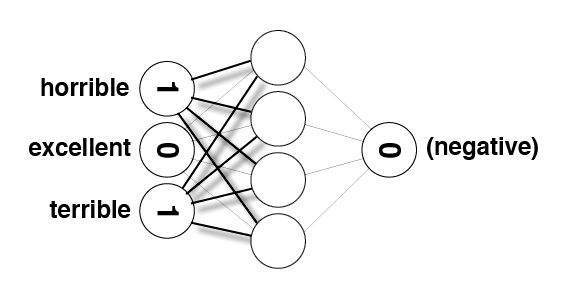

In [52]:
Image(filename='sentiment_network_sparse_2.png')

In [53]:
# words most frequently seen in a review with a "POSITIVE" label
pos_neg_ratios.most_common()

[('edie', 4.6913478822291435),
 ('paulie', 4.07753744390572),
 ('felix', 3.152736022363656),
 ('polanski', 2.8233610476132043),
 ('matthau', 2.80672172860924),
 ('victoria', 2.681021528714291),
 ('mildred', 2.6026896854443837),
 ('gandhi', 2.538973871058276),
 ('flawless', 2.451005098112319),
 ('superbly', 2.26002547857525),
 ('perfection', 2.159484249353372),
 ('astaire', 2.1400661634962708),
 ('captures', 2.038619547159581),
 ('voight', 2.030170492673053),
 ('wonderfully', 2.0218960560332353),
 ('powell', 1.978345424808467),
 ('brosnan', 1.9547990964725592),
 ('lily', 1.9203768470501485),
 ('bakshi', 1.9029851043382795),
 ('lincoln', 1.9014583864844796),
 ('refreshing', 1.8551812956655511),
 ('breathtaking', 1.8481124057791867),
 ('bourne', 1.8478489358790986),
 ('lemmon', 1.8458266904983307),
 ('delightful', 1.8002701588959635),
 ('flynn', 1.7996646487351682),
 ('andrews', 1.7764919970972666),
 ('homer', 1.7692866133759964),
 ('beautifully', 1.7626953362841438),
 ('soccer', 1.757857

In [54]:
# words most frequently seen in a review with a "NEGATIVE" label
list(reversed(pos_neg_ratios.most_common()))[0:30]

[('boll', -4.07781526027089),
 ('uwe', -3.921875301871158),
 ('seagal', -3.320250105858192),
 ('unwatchable', -3.0269848170580955),
 ('stinker', -2.9876839403711624),
 ('mst', -2.775383321170797),
 ('incoherent', -2.7641396677532537),
 ('unfunny', -2.5545257844967644),
 ('waste', -2.4907515123361046),
 ('blah', -2.4475792789485005),
 ('horrid', -2.371577964480997),
 ('pointless', -2.345107387713634),
 ('atrocious', -2.3187369339642556),
 ('redeeming', -2.2667790015910296),
 ('prom', -2.2601040980178784),
 ('drivel', -2.247602958576693),
 ('lousy', -2.2118080125207054),
 ('worst', -2.1930856334332267),
 ('laughable', -2.172468615469592),
 ('awful', -2.1385076866397488),
 ('poorly', -2.132613384420701),
 ('wasting', -2.117815554561451),
 ('remotely', -2.111046881095167),
 ('existent', -2.0024805005437076),
 ('boredom', -1.9241486572738005),
 ('miserably', -1.921661093801999),
 ('sucks', -1.9166645809588516),
 ('uninspired', -1.9131499212248517),
 ('lame', -1.9117232884159072),
 ('insult'

In [55]:
from bokeh.models import ColumnDataSource, LabelSet
from bokeh.plotting import figure, show, output_file
from bokeh.io import output_notebook
output_notebook()

Loading BokehJS ...

In [56]:
hist, edges = np.histogram(list(map(lambda x:x[1],pos_neg_ratios.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="Word Positive/Negative Affinity Distribution")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

C:\Users\Sai Ram\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: The normed argument is ignored when density is provided. In future passing both will result in an error.
  """Entry point for launching an IPython kernel.


In [57]:
frequency_frequency = Counter()

for word, cnt in total_counts.most_common():
    frequency_frequency[cnt] += 1

In [58]:
hist, edges = np.histogram(list(map(lambda x:x[1],frequency_frequency.most_common())), density=True, bins=100, normed=True)

p = figure(tools="pan,wheel_zoom,reset,save",
           toolbar_location="above",
           title="The frequency distribution of the words in our corpus")
p.quad(top=hist, bottom=0, left=edges[:-1], right=edges[1:], line_color="#555555")
show(p)

C:\Users\Sai Ram\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: DeprecationWarning: The normed argument is ignored when density is provided. In future passing both will result in an error.
  """Entry point for launching an IPython kernel.


# Project 6: Reducing Noise by Strategically Reducing the Vocabulary<a id='project_6'></a>

**TODO:** Improve `SentimentNetwork`'s performance by reducing more noise in the vocabulary. Specifically, do the following:
* Copy the `SentimentNetwork` class from the previous project into the following cell.
* Modify `pre_process_data`:
>* Add two additional parameters: `min_count` and `polarity_cutoff`
>* Calculate the positive-to-negative ratios of words used in the reviews. (You can use code you've written elsewhere in the notebook, but we are moving it into the class like we did with other helper code earlier.)  
>* Change so words are only added to the vocabulary if they occur in the vocabulary more than `min_count` times.
>* Change so words are only added to the vocabulary if the absolute value of their postive-to-negative ratio is at least `polarity_cutoff`
* Modify `__init__`:
>* Add the same two parameters (`min_count` and `polarity_cutoff`) and use them when you call `pre_process_data`

In [61]:
import time
import sys
import numpy as np

# Encapsulate our neural network in a class
class SentimentNetwork:
    ## New for Project 6: added min_count and polarity_cutoff parameters
    def __init__(self, reviews,labels,min_count = 10,polarity_cutoff = 0.1,hidden_nodes = 10, learning_rate = 0.1):
        """Create a SentimenNetwork with the given settings
        Args:
            reviews(list) - List of reviews used for training
            labels(list) - List of POSITIVE/NEGATIVE labels associated with the given reviews
            min_count(int) - Words should only be added to the vocabulary 
                             if they occur more than this many times
            polarity_cutoff(float) - The absolute value of a word's positive-to-negative
                                     ratio must be at least this big to be considered.
            hidden_nodes(int) - Number of nodes to create in the hidden layer
            learning_rate(float) - Learning rate to use while training
        
        """
        # Assign a seed to our random number generator to ensure we get
        # reproducable results during development 
        np.random.seed(1)

        # process the reviews and their associated labels so that everything
        # is ready for training
        ## New for Project 6: added min_count and polarity_cutoff arguments to pre_process_data call
        self.pre_process_data(reviews, labels, polarity_cutoff, min_count)
        
        # Build the network to have the number of hidden nodes and the learning rate that
        # were passed into this initializer. Make the same number of input nodes as
        # there are vocabulary words and create a single output node.
        self.init_network(len(self.review_vocab),hidden_nodes, 1, learning_rate)

    ## New for Project 6: added min_count and polarity_cutoff parameters
    def pre_process_data(self, reviews, labels, polarity_cutoff, min_count):
        
        ## ----------------------------------------
        ## New for Project 6: Calculate positive-to-negative ratios for words before
        #                     building vocabulary
        #
        positive_counts = Counter()
        negative_counts = Counter()
        total_counts = Counter()

        for i in range(len(reviews)):
            if(labels[i] == 'POSITIVE'):
                for word in reviews[i].split(" "):
                    positive_counts[word] += 1
                    total_counts[word] += 1
            else:
                for word in reviews[i].split(" "):
                    negative_counts[word] += 1
                    total_counts[word] += 1

        pos_neg_ratios = Counter()

        for term,cnt in list(total_counts.most_common()):
            if(cnt >= 50):
                pos_neg_ratio = positive_counts[term] / float(negative_counts[term]+1)
                pos_neg_ratios[term] = pos_neg_ratio

        for word,ratio in pos_neg_ratios.most_common():
            if(ratio > 1):
                pos_neg_ratios[word] = np.log(ratio)
            else:
                pos_neg_ratios[word] = -np.log((1 / (ratio + 0.01)))
        #
        ## end New for Project 6
        ## ----------------------------------------

        # populate review_vocab with all of the words in the given reviews
        review_vocab = set()
        for review in reviews:
            for word in review.split(" "):
                ## New for Project 6: only add words that occur at least min_count times
                #                     and for words with pos/neg ratios, only add words
                #                     that meet the polarity_cutoff
                if(total_counts[word] > min_count):
                    if(word in pos_neg_ratios.keys()):
                        if((pos_neg_ratios[word] >= polarity_cutoff) or (pos_neg_ratios[word] <= -polarity_cutoff)):
                            review_vocab.add(word)
                    else:
                        review_vocab.add(word)

        # Convert the vocabulary set to a list so we can access words via indices
        self.review_vocab = list(review_vocab)
        
        # populate label_vocab with all of the words in the given labels.
        label_vocab = set()
        for label in labels:
            label_vocab.add(label)
        
        # Convert the label vocabulary set to a list so we can access labels via indices
        self.label_vocab = list(label_vocab)
        
        # Store the sizes of the review and label vocabularies.
        self.review_vocab_size = len(self.review_vocab)
        self.label_vocab_size = len(self.label_vocab)
        
        # Create a dictionary of words in the vocabulary mapped to index positions
        self.word2index = {}
        for i, word in enumerate(self.review_vocab):
            self.word2index[word] = i
        
        # Create a dictionary of labels mapped to index positions
        self.label2index = {}
        for i, label in enumerate(self.label_vocab):
            self.label2index[label] = i

    def init_network(self, input_nodes, hidden_nodes, output_nodes, learning_rate):
        # Set number of nodes in input, hidden and output layers.
        self.input_nodes = input_nodes
        self.hidden_nodes = hidden_nodes
        self.output_nodes = output_nodes

        # Store the learning rate
        self.learning_rate = learning_rate

        # Initialize weights

        # These are the weights between the input layer and the hidden layer.
        self.weights_0_1 = np.zeros((self.input_nodes,self.hidden_nodes))

        # These are the weights between the hidden layer and the output layer.
        self.weights_1_2 = np.random.normal(0.0, self.output_nodes**-0.5, 
                                                (self.hidden_nodes, self.output_nodes))
        
        ## New for Project 5: Removed self.layer_0; added self.layer_1
        # The input layer, a two-dimensional matrix with shape 1 x hidden_nodes
        self.layer_1 = np.zeros((1,hidden_nodes))
    
    ## New for Project 5: Removed update_input_layer function
    
    def get_target_for_label(self,label):
        if(label == 'POSITIVE'):
            return 1
        else:
            return 0
        
    def sigmoid(self,x):
        return 1 / (1 + np.exp(-x))
    
    def sigmoid_output_2_derivative(self,output):
        return output * (1 - output)
    
    ## New for Project 5: changed name of first parameter form 'training_reviews' 
    #                     to 'training_reviews_raw'
    def train(self, training_reviews_raw, training_labels):

        ## New for Project 5: pre-process training reviews so we can deal 
        #                     directly with the indices of non-zero inputs
        training_reviews = list()
        for review in training_reviews_raw:
            indices = set()
            for word in review.split(" "):
                if(word in self.word2index.keys()):
                    indices.add(self.word2index[word])
            training_reviews.append(list(indices))

        # make sure out we have a matching number of reviews and labels
        assert(len(training_reviews) == len(training_labels))
        
        # Keep track of correct predictions to display accuracy during training 
        correct_so_far = 0

        # Remember when we started for printing time statistics
        start = time.time()
        
        # loop through all the given reviews and run a forward and backward pass,
        # updating weights for every item
        for i in range(len(training_reviews)):
            
            # Get the next review and its correct label
            review = training_reviews[i]
            label = training_labels[i]
            
            #### Implement the forward pass here ####
            ### Forward pass ###

            ## New for Project 5: Removed call to 'update_input_layer' function
            #                     because 'layer_0' is no longer used

            # Hidden layer
            ## New for Project 5: Add in only the weights for non-zero items
            self.layer_1 *= 0
            for index in review:
                self.layer_1 += self.weights_0_1[index]

            # Output layer
            ## New for Project 5: changed to use 'self.layer_1' instead of 'local layer_1'
            layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))            
            
            #### Implement the backward pass here ####
            ### Backward pass ###

            # Output error
            layer_2_error = layer_2 - self.get_target_for_label(label) # Output layer error is the difference between desired target and actual output.
            layer_2_delta = layer_2_error * self.sigmoid_output_2_derivative(layer_2)

            # Backpropagated error
            layer_1_error = layer_2_delta.dot(self.weights_1_2.T) # errors propagated to the hidden layer
            layer_1_delta = layer_1_error # hidden layer gradients - no nonlinearity so it's the same as the error

            # Update the weights
            ## New for Project 5: changed to use 'self.layer_1' instead of local 'layer_1'
            self.weights_1_2 -= self.layer_1.T.dot(layer_2_delta) * self.learning_rate # update hidden-to-output weights with gradient descent step
            
            ## New for Project 5: Only update the weights that were used in the forward pass
            for index in review:
                self.weights_0_1[index] -= layer_1_delta[0] * self.learning_rate # update input-to-hidden weights with gradient descent step

            # Keep track of correct predictions.
            if(layer_2 >= 0.5 and label == 'POSITIVE'):
                correct_so_far += 1
            elif(layer_2 < 0.5 and label == 'NEGATIVE'):
                correct_so_far += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the training process. 
            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(training_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct_so_far) + " #Trained:" + str(i+1) \
                             + " Training Accuracy:" + str(correct_so_far * 100 / float(i+1))[:4] + "%")
            if(i % 2500 == 0):
                print("")
    
    def test(self, testing_reviews, testing_labels):
        """
        Attempts to predict the labels for the given testing_reviews,
        and uses the test_labels to calculate the accuracy of those predictions.
        """
        
        # keep track of how many correct predictions we make
        correct = 0

        # we'll time how many predictions per second we make
        start = time.time()

        # Loop through each of the given reviews and call run to predict
        # its label. 
        for i in range(len(testing_reviews)):
            pred = self.run(testing_reviews[i])
            if(pred == testing_labels[i]):
                correct += 1
            
            # For debug purposes, print out our prediction accuracy and speed 
            # throughout the prediction process. 

            elapsed_time = float(time.time() - start)
            reviews_per_second = i / elapsed_time if elapsed_time > 0 else 0
            
            sys.stdout.write("\rProgress:" + str(100 * i/float(len(testing_reviews)))[:4] \
                             + "% Speed(reviews/sec):" + str(reviews_per_second)[0:5] \
                             + " #Correct:" + str(correct) + " #Tested:" + str(i+1) \
                             + " Testing Accuracy:" + str(correct * 100 / float(i+1))[:4] + "%")
    
    def run(self, review):
        """
        Returns a POSITIVE or NEGATIVE prediction for the given review.
        """
        # Run a forward pass through the network, like in the "train" function.
        
        ## New for Project 5: Removed call to update_input_layer function
        #                     because layer_0 is no longer used

        # Hidden layer
        ## New for Project 5: Identify the indices used in the review and then add
        #                     just those weights to layer_1 
        self.layer_1 *= 0
        unique_indices = set()
        for word in review.lower().split(" "):
            if word in self.word2index.keys():
                unique_indices.add(self.word2index[word])
        for index in unique_indices:
            self.layer_1 += self.weights_0_1[index]
        
        # Output layer
        ## New for Project 5: changed to use self.layer_1 instead of local layer_1
        layer_2 = self.sigmoid(self.layer_1.dot(self.weights_1_2))
         
        # Return POSITIVE for values above greater-than-or-equal-to 0.5 in the output layer;
        # return NEGATIVE for other values
        if(layer_2[0] >= 0.5):
            return "POSITIVE"
        else:
            return "NEGATIVE"


Run the following cell to train your network with a small polarity cutoff.

In [62]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=20,polarity_cutoff=0.05,learning_rate=0.01)
mlp.train(reviews[:-1000]*2,labels[:-1000]*2)

Progress:0.0% Speed(reviews/sec):0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:1.68% Speed(reviews/sec):2143. #Correct:602 #Trained:809 Training Accuracy:74.4%

Progress:2.43% Speed(reviews/sec):2065. #Correct:911 #Trained:1169 Training Accuracy:77.9%

Progress:3.28% Speed(reviews/sec):2092. #Correct:1226 #Trained:1578 Training Accuracy:77.6%

Progress:4.13% Speed(reviews/sec):2109. #Correct:1561 #Trained:1986 Training Accuracy:78.6%

Progress:4.89% Speed(reviews/sec):2081. #Correct:1870 #Trained:2350 Training Accuracy:79.5%

Progress:5.20% Speed(reviews/sec):2081. #Correct:1994 #Trained:2501 Training Accuracy:79.7%


Progress:6.50% Speed(reviews/sec):2075. #Correct:2523 #Trained:3122 Training Accuracy:80.8%

Progress:7.32% Speed(reviews/sec):2080. #Correct:2844 #Trained:3519 Training Accuracy:80.8%

Progress:8.18% Speed(reviews/sec):2090. #Correct:3184 #Trained:3928 Training Accuracy:81.0%

Progress:9.00% Speed(reviews/sec):2093. #Correct:3513 #Trained:4324 Training Accuracy:81.2%

Progress:9.72% Speed(reviews/sec):2070. #Correct:3785 #Trained:4668 Training Accuracy:81.0%

Progress:10.4% Speed(reviews/sec):2058. #Correct:4063 #Trained:5001 Training Accuracy:81.2%


Progress:11.3% Speed(reviews/sec):2064. #Correct:4421 #Trained:5430 Training Accuracy:81.4%

Progress:12.1% Speed(reviews/sec):2067. #Correct:4739 #Trained:5818 Training Accuracy:81.4%

Progress:12.8% Speed(reviews/sec):2059. #Correct:5041 #Trained:6185 Training Accuracy:81.5%

Progress:13.7% Speed(reviews/sec):2070. #Correct:5410 #Trained:6611 Training Accuracy:81.8%

Progress:14.5% Speed(reviews/sec):2068. #Correct:5739 #Trained:6989 Training Accuracy:82.1%

Progress:15.3% Speed(reviews/sec):2069. #Correct:6072 #Trained:7382 Training Accuracy:82.2%

Progress:15.6% Speed(reviews/sec):2061. #Correct:6176 #Trained:7501 Training Accuracy:82.3%


Progress:16.8% Speed(reviews/sec):2053. #Correct:6684 #Trained:8094 Training Accuracy:82.5%

Progress:17.5% Speed(reviews/sec):2046. #Correct:6981 #Trained:8446 Training Accuracy:82.6%

Progress:18.3% Speed(reviews/sec):2042. #Correct:7290 #Trained:8814 Training Accuracy:82.7%

Progress:19.0% Speed(reviews/sec):2030. #Correct:7592 #Trained:9146 Training Accuracy:83.0%

Progress:19.8% Speed(reviews/sec):2036. #Correct:7944 #Trained:9551 Training Accuracy:83.1%

Progress:20.6% Speed(reviews/sec):2032. #Correct:8262 #Trained:9917 Training Accuracy:83.3%

Progress:20.8% Speed(reviews/sec):2032. #Correct:8336 #Trained:10001 Training Accuracy:83.3%


Progress:22.2% Speed(reviews/sec):2027. #Correct:8905 #Trained:10660 Training Accuracy:83.5%

Progress:22.9% Speed(reviews/sec):2025. #Correct:9213 #Trained:11019 Training Accuracy:83.6%

Progress:23.7% Speed(reviews/sec):2027. #Correct:9540 #Trained:11410 Training Accuracy:83.6%

Progress:24.5% Speed(reviews/sec):2023. #Correct:9882 #Trained:11800 Training Accuracy:83.7%

Progress:25.3% Speed(reviews/sec):2021. #Correct:10205 #Trained:12168 Training Accuracy:83.8%

Progress:26.0% Speed(reviews/sec):2023. #Correct:10501 #Trained:12501 Training Accuracy:84.0%


Progress:26.9% Speed(reviews/sec):2020. #Correct:10863 #Trained:12918 Training Accuracy:84.0%

Progress:27.7% Speed(reviews/sec):2019. #Correct:11190 #Trained:13301 Training Accuracy:84.1%

Progress:28.4% Speed(reviews/sec):2016. #Correct:11492 #Trained:13647 Training Accuracy:84.2%

Progress:29.2% Speed(reviews/sec):2015. #Correct:11822 #Trained:14021 Training Accuracy:84.3%

Progress:29.9% Speed(reviews/sec):2014. #Correct:12125 #Trained:14387 Training Accuracy:84.2%

Progress:30.7% Speed(reviews/sec):2013. #Correct:12433 #Trained:14760 Training Accuracy:84.2%

Progress:31.2% Speed(reviews/sec):2007. #Correct:12641 #Trained:15001 Training Accuracy:84.2%


Progress:32.1% Speed(reviews/sec):2001. #Correct:13000 #Trained:15422 Training Accuracy:84.2%

Progress:32.9% Speed(reviews/sec):2002. #Correct:13333 #Trained:15804 Training Accuracy:84.3%

Progress:33.6% Speed(reviews/sec):1998. #Correct:13633 #Trained:16165 Training Accuracy:84.3%

Progress:34.4% Speed(reviews/sec):1999. #Correct:13948 #Trained:16533 Training Accuracy:84.3%

Progress:35.2% Speed(reviews/sec):1997. #Correct:14257 #Trained:16899 Training Accuracy:84.3%

Progress:36.0% Speed(reviews/sec):2001. #Correct:14609 #Trained:17301 Training Accuracy:84.4%

Progress:36.4% Speed(reviews/sec):1999. #Correct:14782 #Trained:17501 Training Accuracy:84.4%


Progress:37.5% Speed(reviews/sec):1995. #Correct:15209 #Trained:18003 Training Accuracy:84.4%

Progress:38.2% Speed(reviews/sec):1996. #Correct:15526 #Trained:18378 Training Accuracy:84.4%

Progress:39.0% Speed(reviews/sec):1996. #Correct:15872 #Trained:18761 Training Accuracy:84.6%

Progress:39.8% Speed(reviews/sec):1996. #Correct:16192 #Trained:19127 Training Accuracy:84.6%

Progress:40.5% Speed(reviews/sec):1993. #Correct:16505 #Trained:19482 Training Accuracy:84.7%

Progress:41.4% Speed(reviews/sec):1995. #Correct:16865 #Trained:19898 Training Accuracy:84.7%

Progress:41.6% Speed(reviews/sec):1992. #Correct:16954 #Trained:20001 Training Accuracy:84.7%


Progress:42.8% Speed(reviews/sec):1986. #Correct:17443 #Trained:20559 Training Accuracy:84.8%

Progress:43.5% Speed(reviews/sec):1986. #Correct:17761 #Trained:20921 Training Accuracy:84.8%

Progress:44.3% Speed(reviews/sec):1986. #Correct:18087 #Trained:21295 Training Accuracy:84.9%

Progress:45.1% Speed(reviews/sec):1986. #Correct:18421 #Trained:21673 Training Accuracy:84.9%

Progress:45.9% Speed(reviews/sec):1987. #Correct:18753 #Trained:22054 Training Accuracy:85.0%

Progress:46.7% Speed(reviews/sec):1987. #Correct:19080 #Trained:22430 Training Accuracy:85.0%

Progress:46.8% Speed(reviews/sec):1987. #Correct:19143 #Trained:22501 Training Accuracy:85.0%


Progress:48.4% Speed(reviews/sec):1990. #Correct:19781 #Trained:23242 Training Accuracy:85.1%

Progress:49.2% Speed(reviews/sec):1992. #Correct:20135 #Trained:23640 Training Accuracy:85.1%

Progress:50.1% Speed(reviews/sec):1996. #Correct:20506 #Trained:24052 Training Accuracy:85.2%

Progress:50.9% Speed(reviews/sec):1998. #Correct:20879 #Trained:24454 Training Accuracy:85.3%

Progress:51.8% Speed(reviews/sec):2001. #Correct:21256 #Trained:24868 Training Accuracy:85.4%

Progress:52.0% Speed(reviews/sec):2001. #Correct:21379 #Trained:25001 Training Accuracy:85.5%


Progress:53.5% Speed(reviews/sec):2006. #Correct:21995 #Trained:25690 Training Accuracy:85.6%

Progress:54.4% Speed(reviews/sec):2010. #Correct:22382 #Trained:26114 Training Accuracy:85.7%

Progress:55.1% Speed(reviews/sec):2010. #Correct:22721 #Trained:26484 Training Accuracy:85.7%

Progress:55.9% Speed(reviews/sec):2009. #Correct:23063 #Trained:26854 Training Accuracy:85.8%

Progress:56.7% Speed(reviews/sec):2009. #Correct:23401 #Trained:27227 Training Accuracy:85.9%

Progress:57.2% Speed(reviews/sec):2008. #Correct:23635 #Trained:27501 Training Accuracy:85.9%


Progress:58.2% Speed(reviews/sec):2008. #Correct:24052 #Trained:27972 Training Accuracy:85.9%

Progress:59.1% Speed(reviews/sec):2010. #Correct:24419 #Trained:28381 Training Accuracy:86.0%

Progress:59.9% Speed(reviews/sec):2011. #Correct:24765 #Trained:28765 Training Accuracy:86.0%

Progress:60.7% Speed(reviews/sec):2012. #Correct:25112 #Trained:29164 Training Accuracy:86.1%

Progress:61.6% Speed(reviews/sec):2016. #Correct:25481 #Trained:29587 Training Accuracy:86.1%

Progress:62.4% Speed(reviews/sec):2016. #Correct:25827 #Trained:29976 Training Accuracy:86.1%

Progress:62.5% Speed(reviews/sec):2016. #Correct:25850 #Trained:30001 Training Accuracy:86.1%


Progress:63.9% Speed(reviews/sec):2015. #Correct:26496 #Trained:30715 Training Accuracy:86.2%

Progress:64.7% Speed(reviews/sec):2013. #Correct:26813 #Trained:31060 Training Accuracy:86.3%

Progress:65.2% Speed(reviews/sec):2005. #Correct:27046 #Trained:31318 Training Accuracy:86.3%

Progress:66.0% Speed(reviews/sec):2006. #Correct:27403 #Trained:31702 Training Accuracy:86.4%

Progress:66.9% Speed(reviews/sec):2008. #Correct:27778 #Trained:32117 Training Accuracy:86.4%

Progress:67.7% Speed(reviews/sec):2011. #Correct:28121 #Trained:32501 Training Accuracy:86.5%


Progress:68.6% Speed(reviews/sec):2012. #Correct:28507 #Trained:32936 Training Accuracy:86.5%

Progress:69.4% Speed(reviews/sec):2015. #Correct:28897 #Trained:33354 Training Accuracy:86.6%

Progress:70.3% Speed(reviews/sec):2016. #Correct:29263 #Trained:33758 Training Accuracy:86.6%

Progress:71.1% Speed(reviews/sec):2018. #Correct:29621 #Trained:34158 Training Accuracy:86.7%

Progress:71.9% Speed(reviews/sec):2018. #Correct:29964 #Trained:34539 Training Accuracy:86.7%

Progress:72.7% Speed(reviews/sec):2018. #Correct:30310 #Trained:34924 Training Accuracy:86.7%

Progress:72.9% Speed(reviews/sec):2018. #Correct:30383 #Trained:35001 Training Accuracy:86.8%


Progress:74.4% Speed(reviews/sec):2021. #Correct:31041 #Trained:35733 Training Accuracy:86.8%

Progress:75.2% Speed(reviews/sec):2021. #Correct:31390 #Trained:36117 Training Accuracy:86.9%

Progress:76.0% Speed(reviews/sec):2023. #Correct:31761 #Trained:36526 Training Accuracy:86.9%

Progress:76.9% Speed(reviews/sec):2024. #Correct:32114 #Trained:36921 Training Accuracy:86.9%

Progress:77.7% Speed(reviews/sec):2026. #Correct:32486 #Trained:37332 Training Accuracy:87.0%

Progress:78.1% Speed(reviews/sec):2026. #Correct:32638 #Trained:37501 Training Accuracy:87.0%


Progress:79.4% Speed(reviews/sec):2029. #Correct:33224 #Trained:38151 Training Accuracy:87.0%

Progress:80.3% Speed(reviews/sec):2031. #Correct:33591 #Trained:38572 Training Accuracy:87.0%

Progress:81.1% Speed(reviews/sec):2030. #Correct:33931 #Trained:38945 Training Accuracy:87.1%

Progress:81.8% Speed(reviews/sec):2030. #Correct:34254 #Trained:39306 Training Accuracy:87.1%

Progress:82.7% Speed(reviews/sec):2030. #Correct:34614 #Trained:39705 Training Accuracy:87.1%

Progress:83.3% Speed(reviews/sec):2031. #Correct:34874 #Trained:40001 Training Accuracy:87.1%


Progress:84.3% Speed(reviews/sec):2032. #Correct:35319 #Trained:40498 Training Accuracy:87.2%

Progress:85.1% Speed(reviews/sec):2032. #Correct:35668 #Trained:40887 Training Accuracy:87.2%

Progress:86.0% Speed(reviews/sec):2035. #Correct:36068 #Trained:41320 Training Accuracy:87.2%

Progress:86.9% Speed(reviews/sec):2035. #Correct:36418 #Trained:41713 Training Accuracy:87.3%

Progress:87.7% Speed(reviews/sec):2036. #Correct:36776 #Trained:42099 Training Accuracy:87.3%

Progress:88.5% Speed(reviews/sec):2036. #Correct:37128 #Trained:42484 Training Accuracy:87.3%

Progress:88.5% Speed(reviews/sec):2036. #Correct:37143 #Trained:42501 Training Accuracy:87.3%


Progress:90.1% Speed(reviews/sec):2038. #Correct:37881 #Trained:43296 Training Accuracy:87.4%

Progress:90.9% Speed(reviews/sec):2038. #Correct:38225 #Trained:43676 Training Accuracy:87.5%

Progress:91.8% Speed(reviews/sec):2039. #Correct:38601 #Trained:44088 Training Accuracy:87.5%

Progress:92.6% Speed(reviews/sec):2040. #Correct:38956 #Trained:44478 Training Accuracy:87.5%

Progress:93.5% Speed(reviews/sec):2041. #Correct:39327 #Trained:44884 Training Accuracy:87.6%

Progress:93.7% Speed(reviews/sec):2041. #Correct:39430 #Trained:45001 Training Accuracy:87.6%


Progress:95.2% Speed(reviews/sec):2044. #Correct:40089 #Trained:45724 Training Accuracy:87.6%

Progress:96.1% Speed(reviews/sec):2047. #Correct:40485 #Trained:46162 Training Accuracy:87.7%

Progress:96.9% Speed(reviews/sec):2047. #Correct:40840 #Trained:46560 Training Accuracy:87.7%

Progress:97.8% Speed(reviews/sec):2048. #Correct:41215 #Trained:46972 Training Accuracy:87.7%

Progress:98.7% Speed(reviews/sec):2050. #Correct:41595 #Trained:47395 Training Accuracy:87.7%

Progress:98.9% Speed(reviews/sec):2051. #Correct:41697 #Trained:47501 Training Accuracy:87.7%


Progress:99.9% Speed(reviews/sec):2052. #Correct:42172 #Trained:48000 Training Accuracy:87.8%

And run the following cell to test it's performance. It should be 

In [63]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:63.4% Speed(reviews/sec):3591. #Correct:553 #Tested:635 Testing Accuracy:87.0%

Progress:99.9% Speed(reviews/sec):3629. #Correct:854 #Tested:1000 Testing Accuracy:85.4%

Run the following cell to train your network with a much larger polarity cutoff.

In [64]:
mlp = SentimentNetwork(reviews[:-1000],labels[:-1000],min_count=100,polarity_cutoff=0.05,learning_rate=0.01)
mlp.train(reviews[:-1000]*2,labels[:-1000]*2)

Progress:0.0% Speed(reviews/sec):0 #Correct:1 #Trained:1 Training Accuracy:100.%


Progress:1.84% Speed(reviews/sec):2394. #Correct:658 #Trained:887 Training Accuracy:74.1%

Progress:2.68% Speed(reviews/sec):2317. #Correct:982 #Trained:1291 Training Accuracy:76.0%

Progress:3.72% Speed(reviews/sec):2401. #Correct:1379 #Trained:1788 Training Accuracy:77.1%

Progress:4.67% Speed(reviews/sec):2414. #Correct:1769 #Trained:2245 Training Accuracy:78.7%

Progress:5.20% Speed(reviews/sec):2396. #Correct:1972 #Trained:2501 Training Accuracy:78.8%


Progress:6.42% Speed(reviews/sec):2357. #Correct:2469 #Trained:3083 Training Accuracy:80.0%

Progress:7.38% Speed(reviews/sec):2372. #Correct:2845 #Trained:3547 Training Accuracy:80.2%

Progress:8.39% Speed(reviews/sec):2394. #Correct:3241 #Trained:4029 Training Accuracy:80.4%

Progress:9.34% Speed(reviews/sec):2398. #Correct:3611 #Trained:4485 Training Accuracy:80.5%

Progress:10.1% Speed(reviews/sec):2373. #Correct:3941 #Trained:4884 Training Accuracy:80.6%

Progress:10.4% Speed(reviews/sec):2366. #Correct:4029 #Trained:5001 Training Accuracy:80.5%


Progress:12.0% Speed(reviews/sec):2373. #Correct:4668 #Trained:5774 Training Accuracy:80.8%

Progress:12.8% Speed(reviews/sec):2346. #Correct:4977 #Trained:6151 Training Accuracy:80.9%

Progress:13.8% Speed(reviews/sec):2368. #Correct:5410 #Trained:6652 Training Accuracy:81.3%

Progress:14.7% Speed(reviews/sec):2357. #Correct:5764 #Trained:7061 Training Accuracy:81.6%

Progress:15.6% Speed(reviews/sec):2362. #Correct:6134 #Trained:7501 Training Accuracy:81.7%


Progress:16.6% Speed(reviews/sec):2376. #Correct:6571 #Trained:8008 Training Accuracy:82.0%

Progress:17.6% Speed(reviews/sec):2383. #Correct:6970 #Trained:8478 Training Accuracy:82.2%

Progress:18.6% Speed(reviews/sec):2388. #Correct:7368 #Trained:8945 Training Accuracy:82.3%

Progress:19.6% Speed(reviews/sec):2398. #Correct:7795 #Trained:9431 Training Accuracy:82.6%

Progress:20.6% Speed(reviews/sec):2407. #Correct:8217 #Trained:9920 Training Accuracy:82.8%

Progress:20.8% Speed(reviews/sec):2407. #Correct:8287 #Trained:10001 Training Accuracy:82.8%


Progress:22.5% Speed(reviews/sec):2412. #Correct:9016 #Trained:10846 Training Accuracy:83.1%

Progress:23.5% Speed(reviews/sec):2410. #Correct:9389 #Trained:11286 Training Accuracy:83.1%

Progress:24.5% Speed(reviews/sec):2418. #Correct:9805 #Trained:11776 Training Accuracy:83.2%

Progress:25.4% Speed(reviews/sec):2418. #Correct:10199 #Trained:12230 Training Accuracy:83.3%

Progress:26.0% Speed(reviews/sec):2421. #Correct:10436 #Trained:12501 Training Accuracy:83.4%


Progress:27.4% Speed(reviews/sec):2427. #Correct:11023 #Trained:13187 Training Accuracy:83.5%

Progress:28.4% Speed(reviews/sec):2429. #Correct:11426 #Trained:13651 Training Accuracy:83.7%

Progress:29.5% Speed(reviews/sec):2436. #Correct:11858 #Trained:14162 Training Accuracy:83.7%

Progress:30.5% Speed(reviews/sec):2442. #Correct:12252 #Trained:14643 Training Accuracy:83.6%

Progress:31.2% Speed(reviews/sec):2440. #Correct:12564 #Trained:15001 Training Accuracy:83.7%


Progress:32.3% Speed(reviews/sec):2439. #Correct:13025 #Trained:15541 Training Accuracy:83.8%

Progress:33.3% Speed(reviews/sec):2442. #Correct:13418 #Trained:16014 Training Accuracy:83.7%

Progress:34.3% Speed(reviews/sec):2446. #Correct:13838 #Trained:16504 Training Accuracy:83.8%

Progress:35.3% Speed(reviews/sec):2447. #Correct:14227 #Trained:16967 Training Accuracy:83.8%

Progress:36.3% Speed(reviews/sec):2450. #Correct:14637 #Trained:17444 Training Accuracy:83.9%

Progress:36.4% Speed(reviews/sec):2449. #Correct:14691 #Trained:17501 Training Accuracy:83.9%


Progress:38.2% Speed(reviews/sec):2451. #Correct:15433 #Trained:18373 Training Accuracy:83.9%

Progress:39.2% Speed(reviews/sec):2452. #Correct:15857 #Trained:18845 Training Accuracy:84.1%

Progress:40.2% Speed(reviews/sec):2452. #Correct:16256 #Trained:19302 Training Accuracy:84.2%

Progress:41.1% Speed(reviews/sec):2451. #Correct:16641 #Trained:19755 Training Accuracy:84.2%

Progress:41.6% Speed(reviews/sec):2451. #Correct:16855 #Trained:20001 Training Accuracy:84.2%


Progress:43.0% Speed(reviews/sec):2451. #Correct:17431 #Trained:20668 Training Accuracy:84.3%

Progress:43.9% Speed(reviews/sec):2447. #Correct:17808 #Trained:21097 Training Accuracy:84.4%

Progress:44.9% Speed(reviews/sec):2450. #Correct:18220 #Trained:21577 Training Accuracy:84.4%

Progress:45.9% Speed(reviews/sec):2451. #Correct:18630 #Trained:22049 Training Accuracy:84.4%

Progress:46.8% Speed(reviews/sec):2450. #Correct:19022 #Trained:22501 Training Accuracy:84.5%


Progress:47.8% Speed(reviews/sec):2452. #Correct:19427 #Trained:22978 Training Accuracy:84.5%

Progress:48.8% Speed(reviews/sec):2451. #Correct:19820 #Trained:23434 Training Accuracy:84.5%

Progress:49.7% Speed(reviews/sec):2451. #Correct:20238 #Trained:23896 Training Accuracy:84.6%

Progress:50.7% Speed(reviews/sec):2453. #Correct:20676 #Trained:24371 Training Accuracy:84.8%

Progress:51.7% Speed(reviews/sec):2455. #Correct:21099 #Trained:24850 Training Accuracy:84.9%

Progress:52.0% Speed(reviews/sec):2454. #Correct:21239 #Trained:25001 Training Accuracy:84.9%


Progress:53.8% Speed(reviews/sec):2461. #Correct:21977 #Trained:25832 Training Accuracy:85.0%

Progress:54.7% Speed(reviews/sec):2461. #Correct:22400 #Trained:26299 Training Accuracy:85.1%

Progress:55.7% Speed(reviews/sec):2461. #Correct:22822 #Trained:26762 Training Accuracy:85.2%

Progress:56.7% Speed(reviews/sec):2463. #Correct:23247 #Trained:27237 Training Accuracy:85.3%

Progress:57.2% Speed(reviews/sec):2462. #Correct:23471 #Trained:27501 Training Accuracy:85.3%


Progress:58.7% Speed(reviews/sec):2465. #Correct:24078 #Trained:28190 Training Accuracy:85.4%

Progress:59.7% Speed(reviews/sec):2466. #Correct:24494 #Trained:28661 Training Accuracy:85.4%

Progress:60.6% Speed(reviews/sec):2464. #Correct:24876 #Trained:29097 Training Accuracy:85.4%

Progress:61.6% Speed(reviews/sec):2466. #Correct:25298 #Trained:29585 Training Accuracy:85.5%

Progress:62.5% Speed(reviews/sec):2466. #Correct:25662 #Trained:30001 Training Accuracy:85.5%


Progress:63.6% Speed(reviews/sec):2470. #Correct:26153 #Trained:30555 Training Accuracy:85.5%

Progress:64.5% Speed(reviews/sec):2467. #Correct:26541 #Trained:30989 Training Accuracy:85.6%

Progress:65.5% Speed(reviews/sec):2467. #Correct:26961 #Trained:31450 Training Accuracy:85.7%

Progress:66.5% Speed(reviews/sec):2468. #Correct:27386 #Trained:31926 Training Accuracy:85.7%

Progress:67.5% Speed(reviews/sec):2470. #Correct:27815 #Trained:32410 Training Accuracy:85.8%

Progress:67.7% Speed(reviews/sec):2470. #Correct:27898 #Trained:32501 Training Accuracy:85.8%


Progress:69.5% Speed(reviews/sec):2472. #Correct:28668 #Trained:33362 Training Accuracy:85.9%

Progress:70.4% Speed(reviews/sec):2472. #Correct:29092 #Trained:33834 Training Accuracy:85.9%

Progress:71.4% Speed(reviews/sec):2473. #Correct:29511 #Trained:34308 Training Accuracy:86.0%

Progress:72.4% Speed(reviews/sec):2474. #Correct:29926 #Trained:34778 Training Accuracy:86.0%

Progress:72.9% Speed(reviews/sec):2474. #Correct:30126 #Trained:35001 Training Accuracy:86.0%


Progress:74.4% Speed(reviews/sec):2475. #Correct:30772 #Trained:35729 Training Accuracy:86.1%

Progress:75.3% Speed(reviews/sec):2474. #Correct:31173 #Trained:36177 Training Accuracy:86.1%

Progress:76.3% Speed(reviews/sec):2475. #Correct:31604 #Trained:36660 Training Accuracy:86.2%

Progress:77.3% Speed(reviews/sec):2475. #Correct:32013 #Trained:37121 Training Accuracy:86.2%

Progress:78.1% Speed(reviews/sec):2475. #Correct:32355 #Trained:37501 Training Accuracy:86.2%


Progress:79.3% Speed(reviews/sec):2477. #Correct:32871 #Trained:38073 Training Accuracy:86.3%

Progress:80.3% Speed(reviews/sec):2479. #Correct:33308 #Trained:38581 Training Accuracy:86.3%

Progress:81.3% Speed(reviews/sec):2478. #Correct:33712 #Trained:39030 Training Accuracy:86.3%

Progress:82.2% Speed(reviews/sec):2477. #Correct:34098 #Trained:39476 Training Accuracy:86.3%

Progress:83.2% Speed(reviews/sec):2478. #Correct:34512 #Trained:39946 Training Accuracy:86.3%

Progress:83.3% Speed(reviews/sec):2478. #Correct:34556 #Trained:40001 Training Accuracy:86.3%


Progress:85.1% Speed(reviews/sec):2477. #Correct:35319 #Trained:40863 Training Accuracy:86.4%

Progress:86.1% Speed(reviews/sec):2477. #Correct:35754 #Trained:41338 Training Accuracy:86.4%

Progress:87.0% Speed(reviews/sec):2475. #Correct:36135 #Trained:41768 Training Accuracy:86.5%

Progress:87.9% Speed(reviews/sec):2474. #Correct:36539 #Trained:42213 Training Accuracy:86.5%

Progress:88.5% Speed(reviews/sec):2473. #Correct:36798 #Trained:42501 Training Accuracy:86.5%


Progress:89.7% Speed(reviews/sec):2471. #Correct:37325 #Trained:43081 Training Accuracy:86.6%

Progress:90.6% Speed(reviews/sec):2470. #Correct:37730 #Trained:43525 Training Accuracy:86.6%

Progress:91.5% Speed(reviews/sec):2468. #Correct:38111 #Trained:43958 Training Accuracy:86.6%

Progress:92.4% Speed(reviews/sec):2466. #Correct:38498 #Trained:44382 Training Accuracy:86.7%

Progress:93.3% Speed(reviews/sec):2464. #Correct:38867 #Trained:44803 Training Accuracy:86.7%

Progress:93.7% Speed(reviews/sec):2463. #Correct:39047 #Trained:45001 Training Accuracy:86.7%


Progress:95.2% Speed(reviews/sec):2464. #Correct:39698 #Trained:45729 Training Accuracy:86.8%

Progress:96.2% Speed(reviews/sec):2464. #Correct:40119 #Trained:46203 Training Accuracy:86.8%

Progress:97.1% Speed(reviews/sec):2463. #Correct:40494 #Trained:46638 Training Accuracy:86.8%

Progress:98.1% Speed(reviews/sec):2464. #Correct:40929 #Trained:47118 Training Accuracy:86.8%

Progress:98.9% Speed(reviews/sec):2462. #Correct:41271 #Trained:47501 Training Accuracy:86.8%


Progress:99.9% Speed(reviews/sec):2460. #Correct:41717 #Trained:47974 Training Accuracy:86.9%

Progress:99.9% Speed(reviews/sec):2460. #Correct:41738 #Trained:48000 Training Accuracy:86.9%

And run the following cell to test it's performance.

In [65]:
mlp.test(reviews[-1000:],labels[-1000:])

Progress:58.2% Speed(reviews/sec):3864. #Correct:519 #Tested:583 Testing Accuracy:89.0%

Progress:82.3% Speed(reviews/sec):3856. #Correct:709 #Tested:824 Testing Accuracy:86.0%

Progress:99.9% Speed(reviews/sec):3897. #Correct:860 #Tested:1000 Testing Accuracy:86.0%

# End of Project 6. 

# Checking and predicting some bad reviews taken from google.

The following review shows 1/10 rating on imdb website

In [69]:
mlp.run('I watch a lot of movies and I like to give them all a chance \
just in case there is something interesting or exciting to warrant a \
viewing Unfortunately this movie has none of these features it is pointless and \
offers nothing in the way of story line,acting or direction The plot is non-existent \
with the actors just going through the motions and the dialogue is sooo boring its embarrassing. \
I wish the previous reviewers had posted earlier as this would have saved me 95 mins of my time')

'NEGATIVE'

The following review shows 7/10 rating on imdb website

In [70]:
mlp.run("'Negative' is a dialogue film about trust and courage presenting opposite characters on the run from a cartel.\
There are several well- acted scenes, and others that seem like alternative shots better left out. \
While some plot elements seem contrived, the direction and choreography work in the movie's \
favor to drive a sequence of captivating themes by way of conversation that trample \
the sleaziness and pretentiousness of lesser films, all with the backdrop of a majestic\
desert that connects Los Angeles and Arizona.")

'POSITIVE'